## Table of Contents
- [Introduction](#Introduction)
- [1. Basic Analysis](#1.-Basic-Analysis)
  - [1.1 Creating Trap Dummy Variables](#1.1-Creating-Trap-Dummy-Variables)
  - [1.2 Average Mosquito Counts by Month](#1.2-Average-Mosquito-Counts-by-Month)
- [2. Statistical Analysis](#2.-Statistical-Analysis)
  - [2.1 WNV Prevalence in Different Species](#2.1-WNV-Prevalence-in-Different-Species)
  - [2.2 Correlations with Mosquito Counts](#2.2-Correlations-with-Mosquito-Counts)
- [3. Advanced Statistical Analysis](#3.-Advanced-Statistical-Analysis)
  - [3.1 Linear Regression](#3.1-Linear-Regression)
      - [3.1.1 Preparing the Data for Linear Regression](#3.1.1-Preparing-the-Data-for-Linear-Regression)
      - [3.1.2 Constructing our Linear Regression Model](#3.1.2-Constructing-our-Linear-Regression-Model)
  - [3.2 Logistic Regression](#3.2-Logistic-Regression)
      - [3.2.1 Preparing the Data for Logistic Regression](#3.2.1-Preparing-the-Data-for-Logistic-Regression)
      - [3.2.2 Constructing our Logistic Regression Model](#3.2.2-Constructing-our-Logistic-Regression-Model) 

# Introduction

This notebook presents a structured analysis of mosquito surveillance data to explore relationships between environmental, temporal, and biological variables and two key public health outcomes: mosquito abundance in traps and the presence of West Nile Virus (WNV). The analysis follows a multi-stage process, beginning with data preparation tasks such as converting the WNV Present column into a binary format and generating dummy variables for trap types. We then examine seasonal trends in mosquito activity and assess whether different mosquito species exhibit statistically significant differences in WNV positivity rates. Building on these exploratory findings, we construct and iteratively refine two regression models: a linear regression to understand which variables are associated with higher mosquito counts, and a logistic regression to predict the probability of WNV presence. Throughout, we evaluate model assumptions and performance using appropriate statistical and visual diagnostics, with particular attention to the challenges posed by class imbalance and data constraints.

In [42]:
# import required libraries
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from warnings import filterwarnings
from scipy import stats
from scipy.stats import chi2_contingency #important necessary libraries for statistical analysis
from scipy.stats import pearsonr
from scipy.stats import shapiro 
import statsmodels.api as sm
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score
import statsmodels.api as sm
import os #for setting directory


In [43]:
#set figure size throughout notebook
plt.rcParams["figure.figsize"] = (8.0, 6.0)

In [44]:
#set directory and read csv
os.chdir("C:/Users/emshe/Desktop/BRAINSTATION/PYTHON_MATERIALS/TEST_DATA")
mosquito_df = pd.read_csv("mosquito_data_part_2.csv")
mosquito_df_original = mosquito_df.copy() #create a copy of the original dataframe before making changes

In [45]:
#examine sample of dataframe
display(mosquito_df.sample(10))

,Year,Week,Address Block,Trap,Trap type,Date,Mosquito number,WNV Present,Species,Lat,Lon,Month
2986,2017,24,70XX N MOSELLE AVE,T008,GRAVID,2017-06-19 00:06:00,1,negative,CULEX RESTUANS,42.007998,-87.778235,6
16779,2018,30,100XX W OHARE AIRPORT,T910,GRAVID,2018-07-26 00:07:00,15,positive,CULEX RESTUANS,41.977738,-87.880969,7
6174,2014,31,71XX N HARLEM AVE,T233,GRAVID,2014-07-31 00:07:00,6,negative,CULEX PIPIENS,42.010643,-87.806797,7
13695,2008,23,52XX W 63RD ST,T065,GRAVID,2008-06-11 00:06:00,2,negative,CULEX SALINARIUS,41.778305,-87.754366,6
3495,2016,33,36XX N PITTSBURGH AVE,T011,GRAVID,2016-08-18 00:08:00,45,negative,CULEX RESTUANS,41.945961,-87.832942,8
7109,2013,35,22XX N CANNON DR,T054B,GRAVID,2013-08-29 00:08:00,1,negative,CULEX PIPIENS,41.922064,-87.632233,8
18385,2014,34,71XX N HARLEM AVE,T233,GRAVID,2014-08-21 00:08:00,12,positive,CULEX RESTUANS,42.010650,-87.806797,8
5144,2015,23,89XX S CARPENTER ST,T159,GRAVID,2015-06-11 00:06:00,9,negative,CULEX RESTUANS,41.731447,-87.649722,6
17350,2013,29,82XX S KOSTNER AVE,T225,GRAVID,2013-07-19 00:07:00,50,positive,CULEX RESTUANS,41.742679,-87.731545,7
11335,2010,27,25XX W GRAND AVE,T046,GRAVID,2010-07-13 00:07:00,1,negative,CULEX PIPIENS,41.892220,-87.691698,7


In [46]:
#statistically describe numerical columns
mosquito_df.describe()

,Year,Week,Mosquito number,Lat,Lon,Month
count,18495.000000,18495.000000,18495.000000,18495.000000,18495.000000,18495.000000
mean,2012.905812,31.004001,10.879913,41.852599,-87.712611,7.627088
std,3.725857,4.332020,13.475066,0.115419,0.095409,0.998079
min,2007.000000,20.000000,1.000000,41.644720,-87.880969,5.000000
25%,2010.000000,28.000000,2.000000,41.754148,-87.778235,7.000000
50%,2013.000000,31.000000,5.000000,41.872873,-87.703105,8.000000
75%,2016.000000,34.000000,14.000000,41.970102,-87.643076,8.000000
max,2019.000000,40.000000,50.000000,42.017801,-87.531051,10.000000


In [47]:
#check data types and count non-null values
mosquito_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18495 entries, 0 to 18494
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Year             18495 non-null  int64  
 1   Week             18495 non-null  int64  
 2   Address Block    18495 non-null  object 
 3   Trap             18495 non-null  object 
 4   Trap type        18495 non-null  object 
 5   Date             18495 non-null  object 
 6   Mosquito number  18495 non-null  int64  
 7   WNV Present      18495 non-null  object 
 8   Species          18495 non-null  object 
 9   Lat              18495 non-null  float64
 10  Lon              18495 non-null  float64
 11  Month            18495 non-null  int64  
dtypes: float64(2), int64(4), object(6)
memory usage: 1.7+ MB


# 1. Basic Analysis

## 1.1 Creating Trap Dummy Variables

### Convert the WNV Present column into a binary column and create dummy variables from the Trap type column.

In [48]:
#encode WNV Present as a binary variable
mosquito_df['WNV Present Binary'] = mosquito_df['WNV Present'].map({'negative': 0, 'positive': 1})
mosquito_df = mosquito_df.drop(columns = ['WNV Present'])

In [49]:
#add dummy variable columns for trap type to the dataframe
trap_dummies = pd.get_dummies(mosquito_df['Trap type'],dtype=int)
mosquito_df = pd.concat([mosquito_df, trap_dummies],axis=1)
display(mosquito_df.sample(10)) #confirm new integer columns have successfully been added

,Year,Week,Address Block,Trap,Trap type,Date,Mosquito number,Species,Lat,Lon,Month,WNV Present Binary,CDC,GRAVID,OVI,SENTINEL
6892,2013,39,39XX S ASHLAND AVE,T074,GRAVID,2013-09-26 00:09:00,5,CULEX PIPIENS,41.820859,-87.665108,9,0,0,1,0,0
7392,2013,32,62XX N MCCLELLAN AVE,T236,GRAVID,2013-08-08 00:08:00,11,CULEX PIPIENS,41.994966,-87.770837,8,0,0,1,0,0
13589,2008,25,131XX S BRANDON AVE,T209,GRAVID,2008-06-24 00:06:00,2,CULEX RESTUANS,41.657069,-87.546049,6,0,0,1,0,0
16352,2007,37,127XX S DOTY AVE,T115,CDC,2007-09-19 00:09:00,26,CULEX PIPIENS,41.662392,-87.590177,9,1,1,0,0,0
4809,2015,28,13XX N LARAMIE AVE,T230,GRAVID,2015-07-16 00:07:00,3,CULEX RESTUANS,41.904773,-87.755686,7,0,0,1,0,0
2216,2017,38,67XX S KEDZIE AVE,T066,GRAVID,2017-09-21 00:09:00,1,CULEX RESTUANS,41.771199,-87.703107,9,0,0,1,0,0
7658,2013,29,64XX S STONY ISLAND AVE,T077,GRAVID,2013-07-19 00:07:00,1,CULEX RESTUANS,41.778129,-87.586245,7,0,0,1,0,0
8796,2012,29,101XX S STONY ISLAND AVE,T138,GRAVID,2012-07-20 00:07:00,10,CULEX RESTUANS,41.710542,-87.584559,7,1,0,1,0,0
3465,2016,33,100XX W OHARE AIRPORT,T916,GRAVID,2016-08-19 00:08:00,8,CULEX PIPIENS,41.977738,-87.880969,8,0,0,1,0,0
10104,2011,26,79XX S CHICAGO,T083,GRAVID,2011-06-30 00:06:00,1,CULEX RESTUANS,41.754484,-87.590741,6,0,0,1,0,0


We create dummy variables for the categorical trap type column to convert its text categories into a numerical format suitable for regression models.

## 1.2 Average Mosquito Counts by Month

### What is the average number of mosquitoes for each month? What trends do you notice?

In [50]:
#display a table and bar graph showing the average mosquito count by month across all years
monthly_mosq_avg = mosquito_df.groupby('Month')['Mosquito number'].mean().reset_index(name='Mosquito_Avg') #create a df of avg. mosquito count by month
month_map = {5: 'May', 6: 'Jun.', 7: 'Jul.', 8: 'Aug.', 9: 'Sep.', 10: 'Oct.'}
monthly_mosq_avg['Month'] = monthly_mosq_avg['Month'].map(month_map) #map month numbers to their abbreviated names
overall_avg = mosquito_df['Mosquito number'].mean() #find avg. mosquito count across all data
print('Table of Average Mosquito Count by Month Across all Years:')
display(monthly_mosq_avg) #show table
print('\n')
fig = px.bar(data_frame = monthly_mosq_avg, 
                      x = 'Month',
                      y = 'Mosquito_Avg',
                 labels = {'Month':'Month', 'Mosquito_Avg':'Average Mosquito Count'}
) #plot bar graph of avg. mosquito counts
fig.add_trace(
    go.Scatter(
        x=monthly_mosq_avg['Month'],
        y=[overall_avg] * len(monthly_mosq_avg),
        mode='lines',
        name='Overall Average',
        line=dict(color='red', dash='dash')
    ) #add red dashed line indicating overalll average mosquito count
)
fig.update_layout(title={'text': 'Average Mosquito Count by Month Across All Years', 'x': 0.5}) #add and center title
fig.show()

Table of Average Mosquito Count by Month Across all Years:


,Month,Mosquito_Avg
0,May,2.761905
1,Jun.,10.264442
2,Jul.,11.551879
3,Aug.,12.111321
4,Sep.,8.394973
5,Oct.,5.377778


This analysis examines the average number of mosquitoes captured per trap across all years, focusing on the six months available in our data: May through October. These monthly averages reflect mosquito testing and activity in Chicago, where mosquito trapping typically begins in late spring and ends in early fall. The results show a clear seasonal trend. In May, the average mosquito count is relatively low at 2.76, likely reflecting the early stage of mosquito emergence after cooler spring temperatures. The numbers increase substantially in June (10.26) and peak in August (12.11), suggesting that warm summer temperatures and increased humidity support optimal breeding conditions. July also shows a high average (11.55), slightly lower than August but still well above the overall monthly average of approximately 11 mosquitoes. After the peak in August, mosquito counts begin to decline, with averages dropping to 8.39 in September and 5.38 in October, as cooler weather sets in. This pattern highlights the strong seasonality of mosquito populations, with the highest activity occurring in mid to late summer.

# 2. Statistical Analysis

## 2.1 WNV Prevalence in Different Species

### Is there a statistically significant difference between the different mosquito species when looking at the occurrence of West Nile Virus?

Our null hypothesis is: $$H_0\colon \text{there is no significant difference in the probability of a positive WNV test between different species of mosquito} $$
Our alternative hypothesis is: $$H_1\colon \text{there is a significant difference in the probability of a positive WNV test between different species of mosquito} $$


In [51]:
#display a table and bar graph showing the probability of a positive WNV test by species
species_wnv_avg = mosquito_df.groupby('Species')['WNV Present Binary'].mean().reset_index(name='Probability of +WNV') #determine prob. for each species
print('Table of Positive WNV Test Probability by Mosquito Species:')
display(species_wnv_avg) #show table
print('\n')
wnv_avg = mosquito_df['WNV Present Binary'].mean()
fig = px.bar(data_frame = species_wnv_avg, 
                      x = 'Species',
                      y = 'Probability of +WNV'
) #plot bar graph of WNV probabilities
fig.add_trace(
    go.Scatter(
        x=species_wnv_avg['Species'],
        y=[wnv_avg] * len(species_wnv_avg),
        mode='lines',
        name='Overall Average',
        line=dict(color='red', dash='dash')
    ) #add red dashed line indicating overall probability of positive WNV test
)
fig.update_layout(title={'text': 'Probability of Positive WNV Test by Species', 'x': 0.5}) #add and center title
fig.show()

Table of Positive WNV Test Probability by Mosquito Species:


,Species,Probability of +WNV
0,CULEX PIPIENS,0.257382
1,CULEX RESTUANS,0.215490
2,CULEX SALINARIUS,0.048673
3,CULEX TERRITANS,0.015267


In [52]:
#run chi-squared test to determine statistical significance
contingency_table = pd.crosstab(mosquito_df['Species'], mosquito_df['WNV Present Binary']) #make contingency table
chi2, p, dof, expected = chi2_contingency(contingency_table) #run chi-squared test on table and store statistic, degrees of freedom, and p-value
print("Chi-square statistic:", chi2)
print("Degrees of freedom:", dof)
print("p-value:", p)

Chi-square statistic: 311.10394683130164
Degrees of freedom: 3
p-value: 3.930234176440909e-67


To determine whether West Nile Virus (WNV) occurrence differs significantly between mosquito species, we conducted a chi-squared test of independence. The null hypothesis stated that there is no significant difference in the probability of a positive WNV test across species. The results show notable variation in average WNV positivity rates: Culex Pipiens had the highest probability at 25.7%, followed by Culex Restuans at 21.5%, which is close to the overall dataset average of 21.6%. In contrast, Culex Salinarius and Culex Territans showed much lower probabilities at 4.9% and 1.5%, respectively. The chi-squared test yielded a statistic of 311.10 with 3 degrees of freedom (corresponding to four mosquito species minus one), and a p-value of approximately 3.93 × 10⁻⁶⁷, which is far below the conventional 0.05 threshold. This provides strong evidence to reject the null hypothesis and conclude that the occurrence of WNV is significantly associated with mosquito species.

## 2.2 Correlations with Mosquito Counts

### Which columns are positively correlated with the number of mosquitoes caught? Which columns are negatively correlated? Are these correlations statistically significant?

In [53]:
#define function to generate correlation heatmap
def gen_corr_heatmap(df):
    num_df = df.select_dtypes(include = 'number') #restrict to numeric columns
    corr_matrix = num_df.corr() # compute correlation matrix
    fig = px.imshow(
        corr_matrix,
        text_auto=True, #include text
        color_continuous_scale='RdBu', #set color scale
        aspect='auto', #set aspect ratio
        title='Correlation Heatmap of Numeric Columns'
    ) # generate heatmap figure
    fig.update_layout(title={'x': 0.5})
    fig.show()

In [54]:
#generate heatmap of numerical columns in our dataframe
#we survey correlations between all pairs of variables although this question is focused on mosquito number (row 3)
gen_corr_heatmap(mosquito_df)

To identify which variables are associated with the number of mosquitoes caught, we began with an exploratory correlation heatmap that visualizes relationships among all numerical variables. While our primary focus is on mosquito count (row 3), this broader view helps surface indirect patterns and potential confounders. It's important to note that some variables, specifically week and month, are technically categorical in the sense that the numbers themselves, apart from their order, are arbitrary (why should May = 5 and not 1?). Their inclusion here serves an exploratory purpose, with the understanding that numerical operations on them may not reflect true distance or scale.

In [55]:
#display table showing each numerical variables correlation with Mosquito number and its statistical significance (by the Pearson correlation test)
target = 'Mosquito number'
results = []
num_mosquito_df = mosquito_df.select_dtypes(include = 'number') #restrict to numeric columns
for col in num_mosquito_df.columns:
    if col != target:
        corr, p = pearsonr(num_mosquito_df[target], num_mosquito_df[col]) #apply Pearson test to each column
        results.append((col, corr, p)) #store column name, correlation, and p-value


correlation_results = pd.DataFrame(results, columns=['Variable', 'Correlation', 'p-value']) #make summarizing data frame
correlation_results = correlation_results.sort_values(by='Correlation', ascending=False) #sort by correlation
correlation_results['Pos. or Neg. Correlation'] = (correlation_results['Correlation'] > 0) #add column indicating positive or negative corr.
correlation_results['Pos. or Neg. Correlation'] = correlation_results['Pos. or Neg. Correlation'].map({True: 'Positive',False: 'Negative'})
correlation_results['Statistically Significant'] = (correlation_results['p-value'] < .05) #add column indicating statistically significance based on p < .05 convention
display(correlation_results) #show table

,Variable,Correlation,p-value,Pos. or Neg. Correlation,Statistically Significant
5,WNV Present Binary,0.408034,0.000000e+00,Positive,True
0,Year,0.129326,8.393050e-70,Positive,True
9,SENTINEL,0.108575,1.289396e-49,Positive,True
2,Lat,0.096820,9.096861e-40,Positive,True
6,CDC,0.094147,1.095257e-37,Positive,True
8,OVI,-0.005392,4.634395e-01,Negative,False
1,Week,-0.033900,4.002825e-06,Negative,True
4,Month,-0.040426,3.803876e-08,Negative,True
7,GRAVID,-0.138275,1.267816e-79,Negative,True
3,Lon,-0.151421,2.765604e-95,Negative,True


In [56]:
#plot statistically significant correlations with mosquito count on a bar graph

sig_corrs = correlation_results[correlation_results['p-value'] < 0.05] #filter for statistically significant correlations (p < 0.05)

fig = px.bar(
    sig_corrs,
    x='Variable',
    y='Correlation',
    color='Correlation', #include color scale for correlation to emphasize positive vs. negative
    color_continuous_scale='RdBu', #set color scale
    title='Statistically Significant Correlations with Mosquito Number'
) 
fig.update_layout(title={'x': 0.5}, yaxis_title='Correlation Coefficient') #create and center title
fig.show() #display bar chart

We computed Pearson correlation coefficients between Mosquito number and all other numeric variables, along with p-values to assess statistical significance. The trap type OVI was the only numerical variable that appeared insignificant in terms of correlation, which was to be expected as we already know there is only one data point with that trap type. The variable most positively correlated with mosquito count was WNV Present Binary (correlation = 0.41, p < 0.0001), followed by Year, SENTINEL, Latitude, and CDC, all showing weaker but statistically significant positive correlations. It is intuitive that the presence of WNV would correlate with mosquito count as more mosquitos likely means a higher chance of a positive test. Negative correlations were found with GRAVID, Longitude, Month, and Week, with GRAVID and Longitude showing the strongest negative relationships at correlation -.14 and -.15 respectively. These results were visualized in a bar chart, highlighting only those correlations that were statistically significant (p < 0.05). The color scale emphasizes direction and strength of correlation, with blue tones for positive and red for negative associations. Taken together, these findings point to a mix of spatial, temporal, and trap-type influences on mosquito abundance, with some negative and positive correlation but no correlation values exceeding 0.5 in magnitude.

# 3. Advanced Statistical Analysis

## 3.1 Linear Regression

### Run a linear regression to determine how the independent variables affect the number of mosquitoes caught. Explain your model construction process. Analyze the model and the results and discuss the model’s limitations. This may end up being an iterative process. Note: You will likely see a low $R^2$ value, that is to be expected. This dataset does not respond well to performing VIF analysis, so this is not required. WNV Present must not be one of your independent variables.

#### 3.1.1 Preparing the Data for Linear Regression

In [57]:
#check trap type counts
mosquito_df['Trap type'].value_counts()

Trap type
GRAVID      17741
CDC           544
SENTINEL      209
OVI             1
Name: count, dtype: int64

We will proceed in this section with our **num_mosquito_df** which is our dataframe restricted to the numerical columns. If given more time, we could use more dummy variables for other categorical columns (such as species) in this linear regression but we omit this analysis for now. We first drop the OVI column (as there is only one data point with that trap type) and the WNV Present Binary column (as the correlation between the number of mosquitos and the likelihood a test comes back positive may not be meaningful).

In [58]:
#drop OVI and WNV Present Binary columns
cols_to_drop = ['OVI','WNV Present Binary']
num_mosquito_df.drop(columns = cols_to_drop,inplace = True)

There are four assumptions associated with a linear regression model:

1. **Linearity**: The relationship between the predictor and target variables to be linear.
2. **Independence/No Multicollinearity**: The predictor variables are independent of each other.
3. **Residuals** are normally distributed.
4. **Homoscedasticity**: The variance of residual is the same for any value of X.

It is important to note that these assumptions often serve as guidelines rather than strict rules, especially in exploratory or applied modeling contexts like ours. While they help ensure valid inferences and interpretable results, some flexibility is acceptable when the model is used for understanding general trends or generating predictions, rather than drawing formal, rigorous statistical conclusions. If we were conducting hypothesis testing with the intent of publishing statistical findings, stricter adherence to these assumptions would be necessary.

We start by examining **Assumption 1: Linearity.** To check this assumption, we define and run a function that generates scatter plots of potential predictors and a chosen target variable.

In order to investigate Assumption 1, we generated scatter plots comparing each potential independent variable to the number of mosquitoes caught in order to visually assess the assumption of linearity. None of the plots showed clear or strong linear trends, suggesting that any linear relationships—if present—may be weak or obscured by noise. However, the absence of obvious visual patterns does not necessarily mean linear relationships are absent; they may still exist in aggregate or when combined with other predictors. Moreover, we previously confirmed that several of these variables are statistically correlated with mosquito count, which supports the decision to proceed with linear regression. Given the exploratory nature of our analysis, some deviation from strict linearity is acceptable.

In [59]:
#define function to generate scatter plots of dependent and independent variables
def scatter_linear(df,predictors, target):
    for col in predictors:
        sns.scatterplot(data=df, x=col, y=target, alpha=0.5) #generate scatter plot
        plt.title(f'{target} vs. {col}') #plot target variable versus predictor variable
        plt.xlabel(col)
        plt.ylabel(target)
        plt.show()

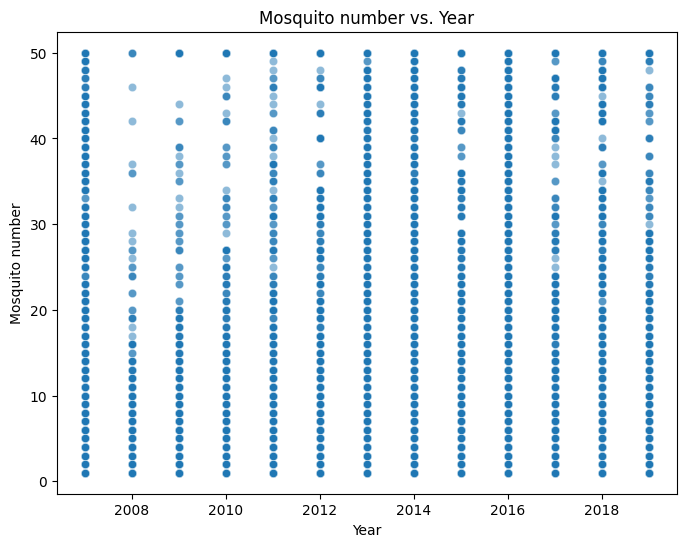

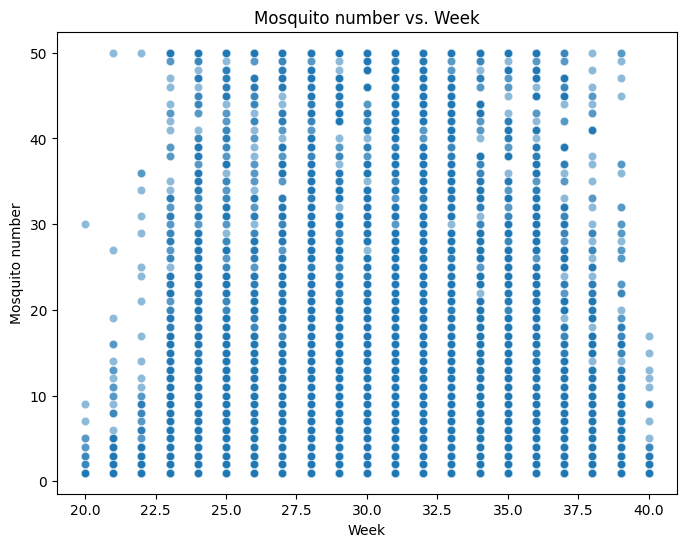

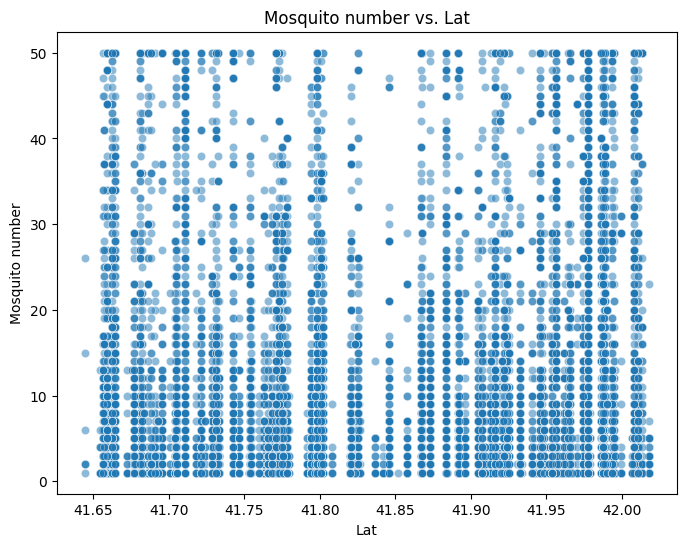

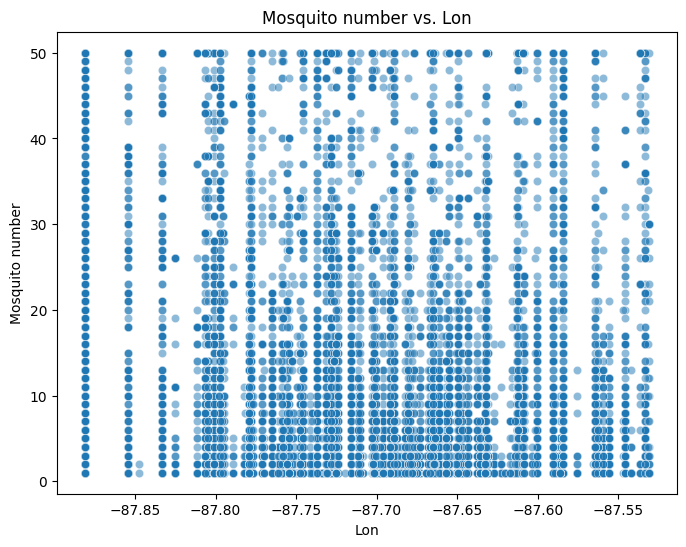

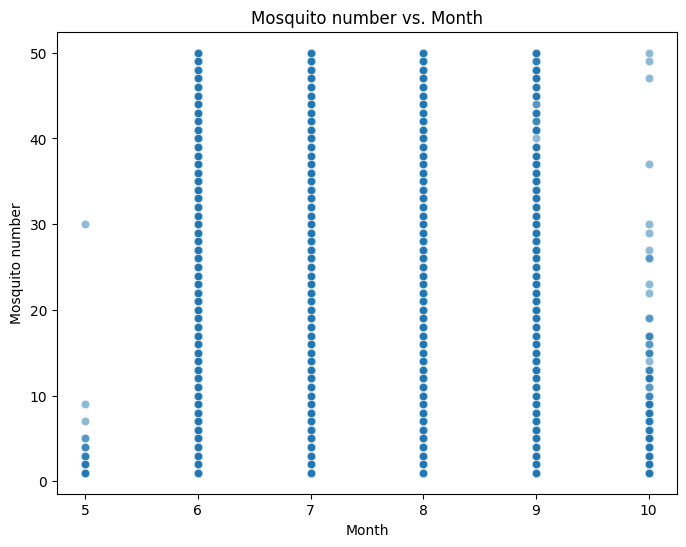

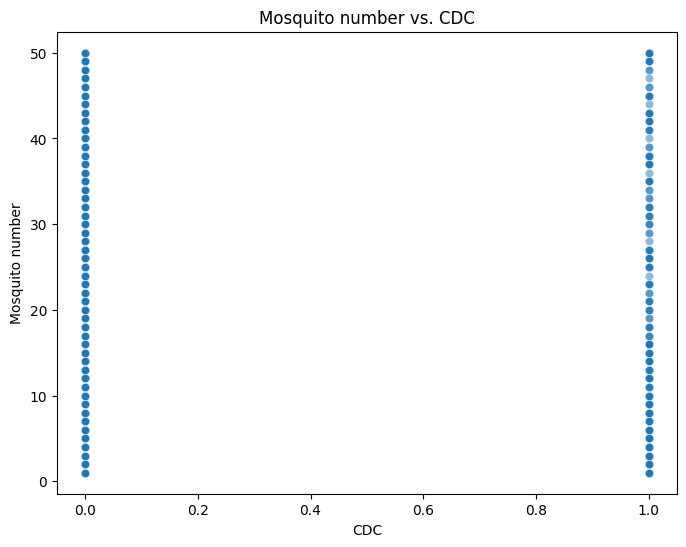

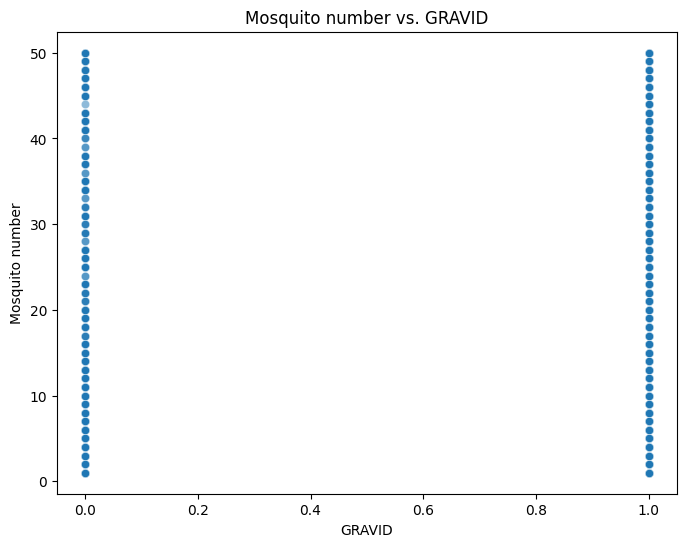

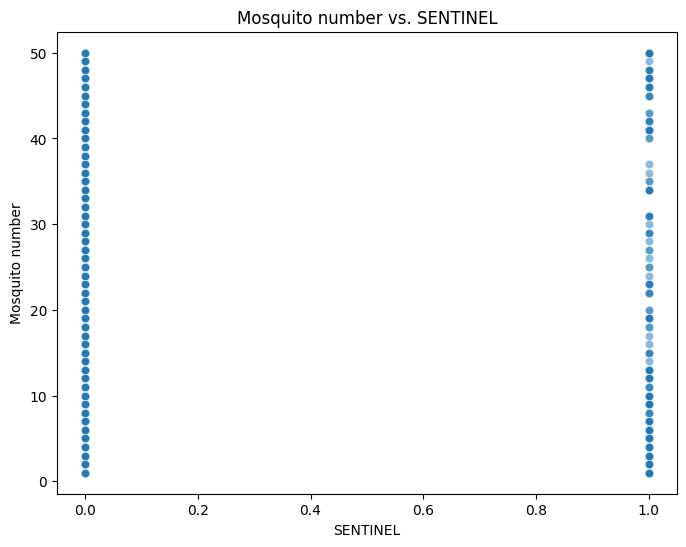

In [60]:
#check whether our initial list of potential predictors have a linear relationship with Mosquito number 
predictors = ['Year','Week','Lat','Lon','Month','CDC','GRAVID','SENTINEL']
target = 'Mosquito number'
scatter_linear(num_mosquito_df,predictors,target)

We next examine **Assumption 2: Independence/No multicollinearity.** We use the function we previously defined to examine a heatmap showing correlation between all the variables we are considering incorporating. We do not use variance inflation factor analysis to check for multicollinearity in this case, because we already know the dataset does not respond well to VIF analysis.

In [61]:
#check for independent variable collinearity with heatmap
gen_corr_heatmap(num_mosquito_df)

The heatmap of independent variables reveals a few pairs of potentially problematic correlations that warrant adjustment before proceeding with linear regression. As expected, Month and Week are highly correlated (r = 0.95), since both represent different ways of expressing time within the year. These columns clearly convey overlapping information, so we will only include one of them in any given model. Latitude and Longitude also show a fairly strong negative correlation (r = -0.75), which may reflect the geographic layout of the trapping area—locations further north may tend to be further west or east in a structured pattern. Nonetheless, because precise geographic positioning is important for our analysis, we will retain both variables. Among the trap type dummy variables, GRAVID and CDC exhibit a correlation of approximately -0.51, which makes sense given that the traps are mutually exclusive categories. To avoid multicollinearity, we will not include all three trap type dummies (CDC, GRAVID, and SENTINEL) in any single model. Beyond these cases, no other pair of independent variables had a correlation (positive or negative) exceeding 0.3 in magnitude. Therefore, after these adjustments, we conclude that our modeling setup satisfies the assumption of avoiding multicollinearity. We now proceed with constructing our model, as the other two assumptions are checked after running linear regression.

#### 3.1.2 Constructing our Linear Regression Model

We begin the linear regression process by defining a set of reusable functions to streamline model evaluation across different sets of independent variables. The **lin_reg_model** function runs an OLS regression, displays a summary of results, and then calls three diagnostic tools to assess model assumptions. Additionally, the function prints three key evaluation metrics: R-squared, which indicates the proportion of variance in the dependent variable explained by the model; Adjusted R-squared, which adjusts for the number of predictors to prevent overfitting; and Mean Squared Error (MSE), which measures the average squared difference between predicted and actual values. These metrics help us assess both the explanatory power and predictive accuracy of the model, with lower MSE and higher R-squared values indicating better performance. 

**residuals_hist** generates a histogram of the residuals to visually evaluate whether they are approximately normally distributed, addressing the assumption of normality. **Q_Q_plot** creates a Q-Q plot of the residuals, which also helps assess normality—ideally, the points fall along the diagonal line. We omit the Shapiro-Wilk test here because our dataset is too large for that test to be reliable. Lastly, **resids_scatter** plots residuals against fitted values to check for homoscedasticity; in a well-specified model, there should be no clear pattern in this plot.

In [62]:
#we define reusable functions so that we can run linear regression and test our model on different choices of variables

#display a histogram of our models' residuals to assess normality
def residuals_hist(resids,dep_var, ind_vars):
    print(f'''Here is a histogram of our residuals using dependent variable {dep_var} and independent variables: {ind_vars}.
    Our residuals should be approximately normally distributed.''') #checking Assumption 3
    plt.hist(resids, bins=30, edgecolor='k', alpha=0.7)
    plt.title('Histogram of Residuals')
    plt.xlabel('Residual')
    plt.ylabel('Frequency')
    plt.show()

#display a Q-Q plot of the residuals to assess normality
def Q_Q_plot(resids,dep_var, ind_vars):
    print(f'''Here is a Normal Q-Q Plot of our residuals using dependent variable {dep_var} independent variables {ind_vars}.
    If our residuals are normally distributed, the points below should approximately fall on the red line.''') #checking Assumption 3
    sm.qqplot(resids, line='45', fit=True)
    plt.title('Q-Q Plot of Residuals')
    plt.show()

#display a scatter plot of our residuals against fitted values to assess homoscedasticity
def resids_scatter(fitted,resids,dep_var,ind_vars):
    print(f'''Here is a scatter plot of our residuals against fitted values using dependent variable {dep_var} and independent variables {ind_vars}.
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.\n''') #checking Assumption 4
    plt.scatter(fitted, resids, alpha=0.4)
    plt.axhline(0, color='red', linestyle='--')
    plt.xlabel('Fitted Values')
    plt.ylabel('Residuals')
    plt.title('Residuals vs Fitted Values')
    plt.show()

#run linear regression for selected variables and visually evaluate model in terms of Assumptions 3 and 4
def lin_reg_model(df,dep_var,ind_vars):
    X = df[ind_vars]
    y = df[dep_var]
    X = sm.add_constant(X)  #add constant for intercept
    model = sm.OLS(y, X)   #instantiate the model
    model_results = model.fit()  #fit model
    residuals = model_results.resid 
    fitted = model_results.fittedvalues
    print(f'Here is a summary of our OLS results using independent variables {ind_vars}.\n')
    print(model_results.summary()) #display summary
    print('\n\n')
    residuals_hist(residuals,dep_var, ind_vars) #check histogram of residuals
    print('\n\n')
    Q_Q_plot(residuals,dep_var,ind_vars) #check Q-Q Plot
    print('\n\n')
    resids_scatter(fitted,residuals,dep_var,ind_vars) #check scatterplot of residuals versus fitted values

    #compute and print important model metrics
    r2 = model_results.rsquared #R^2 value 
    r2_adj = model_results.rsquared_adj #adjusted R^2 value
    mse = np.mean(residuals**2) #Mean Squared Error
    print(f'Final Model Metrics:')
    print(f'R-squared: {r2:.4f}')
    print(f'Adjusted R-squared: {r2_adj:.4f}')
    print(f'Mean Squared Error: {mse:.4f}')

Given the small number of variables we are considering, we will proceed with a backward selection approach for choosing independent variables. We start with the subset of independent variables we found should satisfy Assumptions 1 and 2 (omitting Month and the SENTINEL trap type to avoid colinearity).

Here is a summary of our OLS results using independent variables ['Year', 'Week', 'Lat', 'Lon', 'CDC', 'GRAVID'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.068
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     223.7
Date:                Sun, 04 May 2025   Prob (F-statistic):          9.68e-277
Time:                        20:32:03   Log-Likelihood:                -73697.
No. Observations:               18495   AIC:                         1.474e+05
Df Residuals:                   18488   BIC:                         1.475e+05
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
----------------

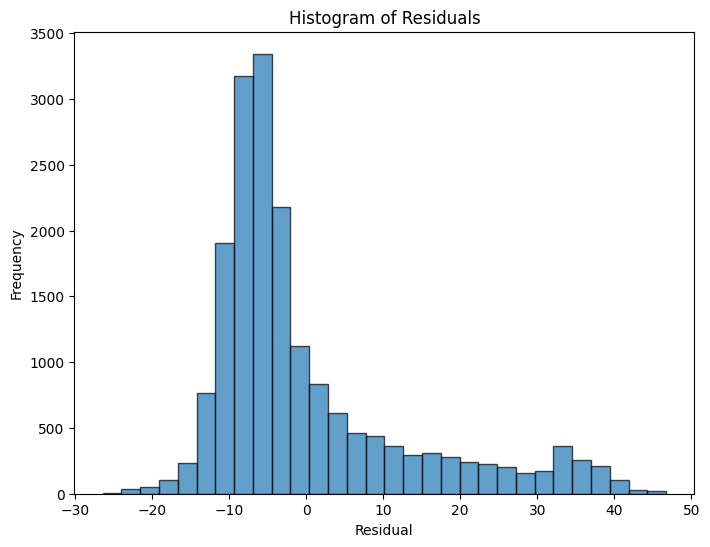




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Year', 'Week', 'Lat', 'Lon', 'CDC', 'GRAVID'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


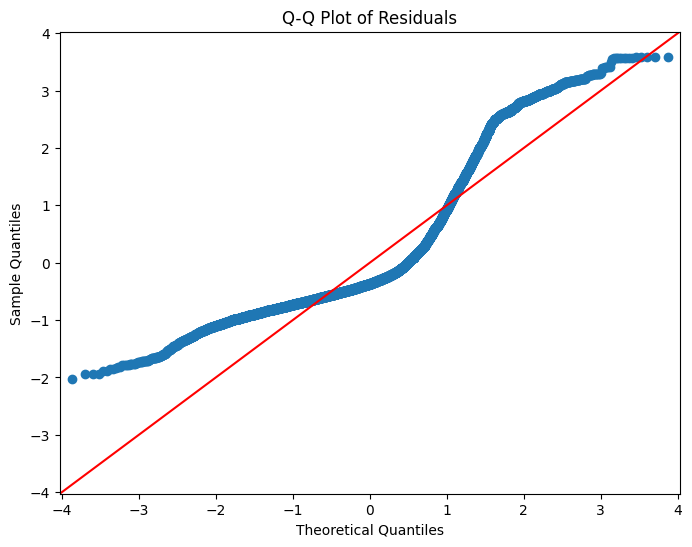




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Year', 'Week', 'Lat', 'Lon', 'CDC', 'GRAVID'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



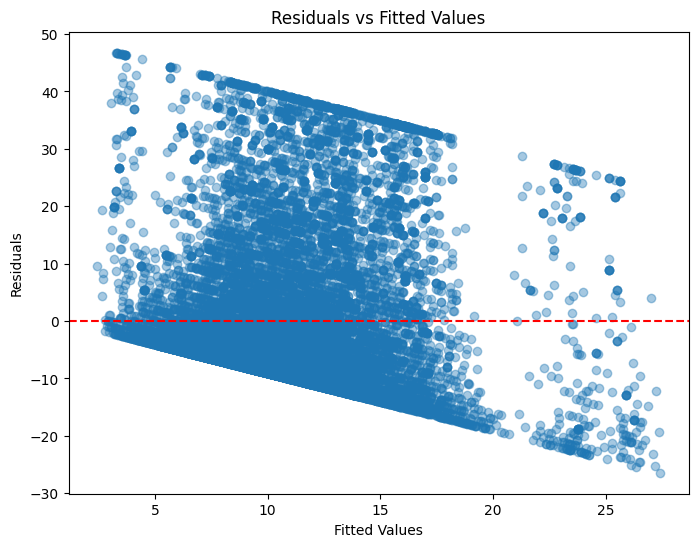

Final Model Metrics:
R-squared: 0.0677
Adjusted R-squared: 0.0674
Mean Squared Error: 169.2805


In [63]:
# linear regression with independent variables: 'Year', 'Week', 'Lat', 'Lon', 'CDC', 'GRAVID'
ind_vars = ['Year', 'Week', 'Lat', 'Lon', 'CDC','GRAVID']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

With these choices of variables, we obtain an R-squared value: 0.0677, Adjusted R-squared value: 0.0674, and Mean Squared Error: 169.2805. We observe that the CDC coefficient has a high p-value of about .079. In terms of checking Assumptions 3 and 4, our visualizations reveal the residuals may not be normally distributed (based on the Q-Q Plot) and there may be some heteroscedasticity. We proceed by replacing the CDC trap type with SENTINEL to see if we get better results.

Here is a summary of our OLS results using independent variables ['Year', 'Week', 'Lat', 'Lon', 'SENTINEL', 'GRAVID'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.068
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     223.7
Date:                Sun, 04 May 2025   Prob (F-statistic):          7.57e-277
Time:                        20:32:03   Log-Likelihood:                -73697.
No. Observations:               18495   AIC:                         1.474e+05
Df Residuals:                   18488   BIC:                         1.475e+05
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------

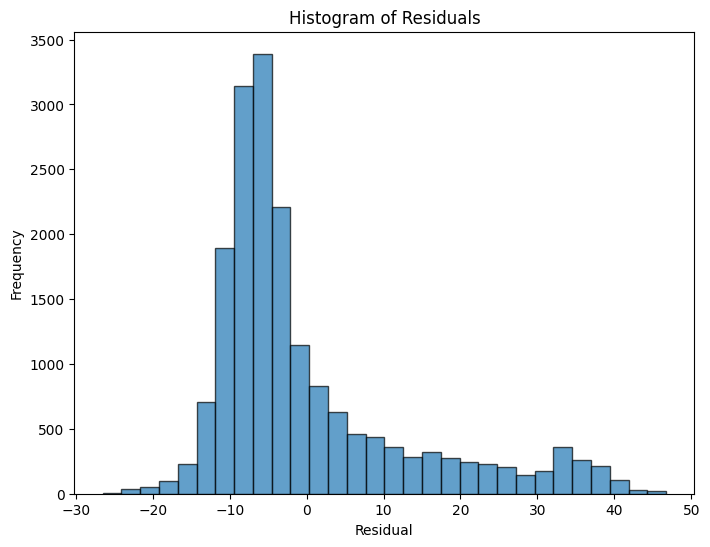




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Year', 'Week', 'Lat', 'Lon', 'SENTINEL', 'GRAVID'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


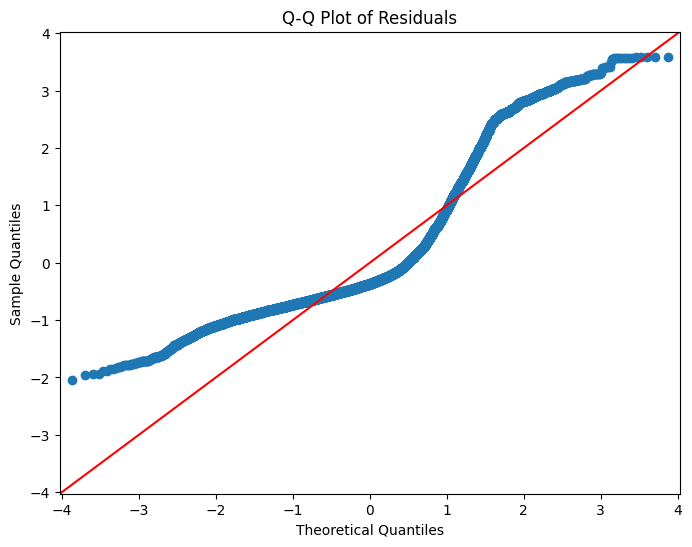




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Year', 'Week', 'Lat', 'Lon', 'SENTINEL', 'GRAVID'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



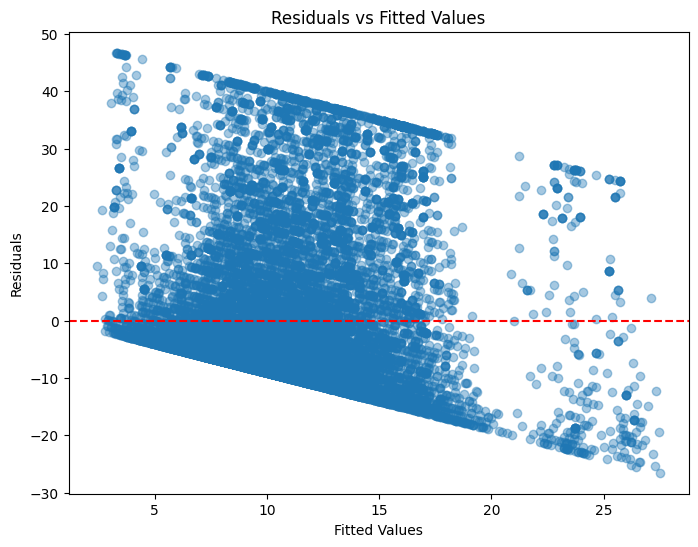

Final Model Metrics:
R-squared: 0.0677
Adjusted R-squared: 0.0674
Mean Squared Error: 169.2760


In [64]:
# linear regression with independent variables: 'Year', 'Week', 'Lat', 'Lon', 'GRAVID', 'SENTINEL'
ind_vars = ['Year', 'Week', 'Lat', 'Lon', 'SENTINEL','GRAVID']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

We obtain very similar results in terms of metrics and visualizations, with the SENTINEL coefficient having a p-value of .058. This is better than what we found for the CDC trap type but still above .05 so we conclude it's better to include only the GRAVID trap type in our model.

Here is a summary of our OLS results using independent variables ['Year', 'Week', 'Lat', 'Lon', 'GRAVID'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.068
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     267.7
Date:                Sun, 04 May 2025   Prob (F-statistic):          2.62e-277
Time:                        20:32:03   Log-Likelihood:                -73699.
No. Observations:               18495   AIC:                         1.474e+05
Df Residuals:                   18489   BIC:                         1.475e+05
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------

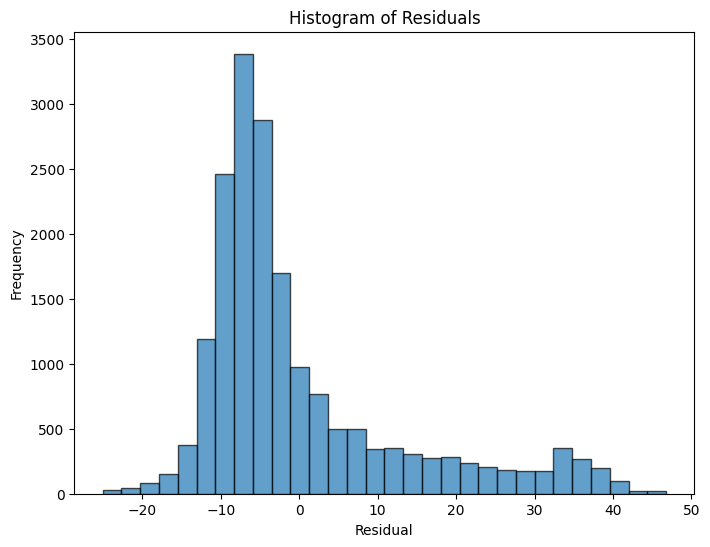




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Year', 'Week', 'Lat', 'Lon', 'GRAVID'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


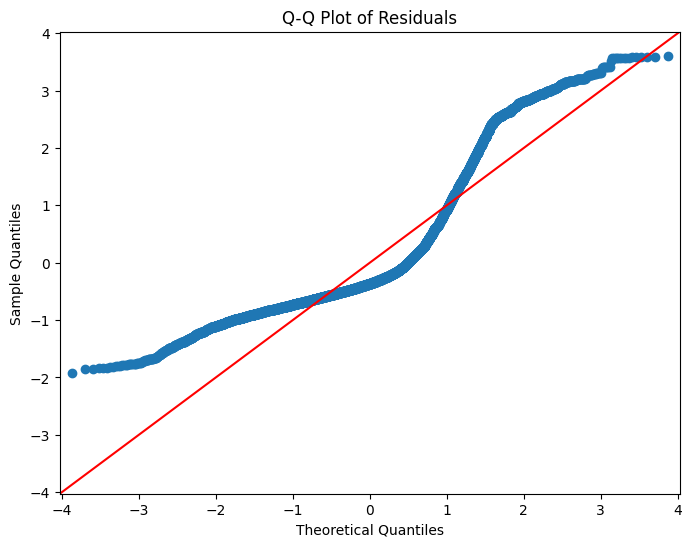




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Year', 'Week', 'Lat', 'Lon', 'GRAVID'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



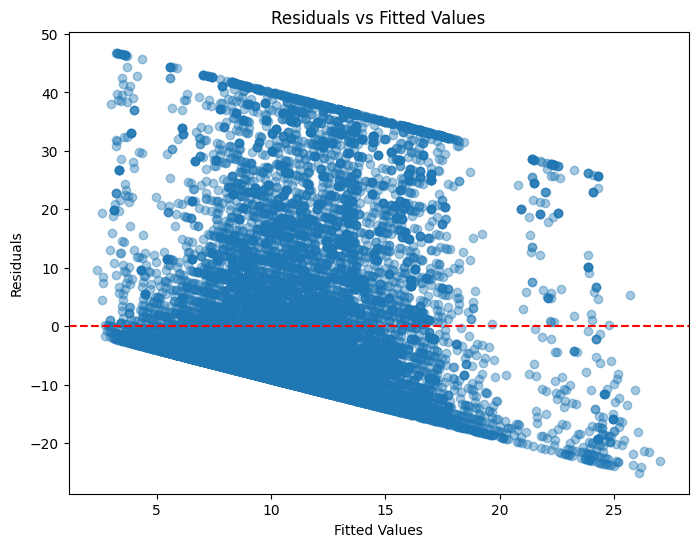

Final Model Metrics:
R-squared: 0.0675
Adjusted R-squared: 0.0673
Mean Squared Error: 169.3088


In [65]:
# linear regression with independent variables: 'Year', 'Week', 'Lat', 'Lon', 'GRAVID'
ind_vars = ['Year', 'Week', 'Lat', 'Lon', 'GRAVID']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

With these choices of variables, all coefficients have p-value < 0.05 and we achieve similar model metrics: R-squared: 0.0675, Adjusted R-squared: 0.0673, Mean Squared Error: 169.3088. This suggests that dropping the other trap types was a good choice. Our visualizations show no improvement in terms of Assumptions 3 and 4, however. Next, we check to see if it's better to use month or week in our regression (we do not want to include both as they are correlated). 

Here is a summary of our OLS results using independent variables ['Year', 'Month', 'Lat', 'Lon', 'GRAVID'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.068
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     267.8
Date:                Sun, 04 May 2025   Prob (F-statistic):          2.53e-277
Time:                        20:32:04   Log-Likelihood:                -73699.
No. Observations:               18495   AIC:                         1.474e+05
Df Residuals:                   18489   BIC:                         1.475e+05
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------

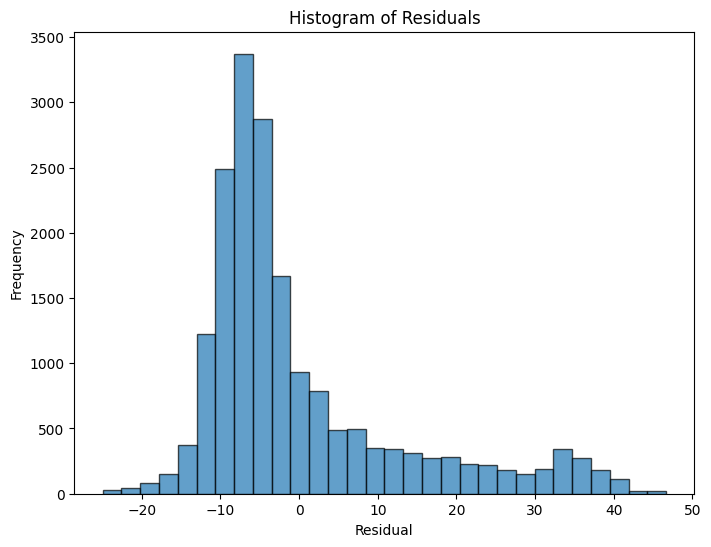




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Year', 'Month', 'Lat', 'Lon', 'GRAVID'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


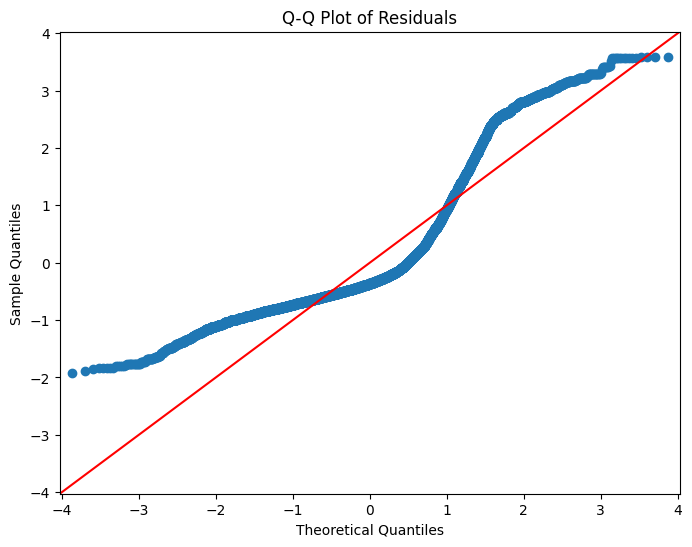




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Year', 'Month', 'Lat', 'Lon', 'GRAVID'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



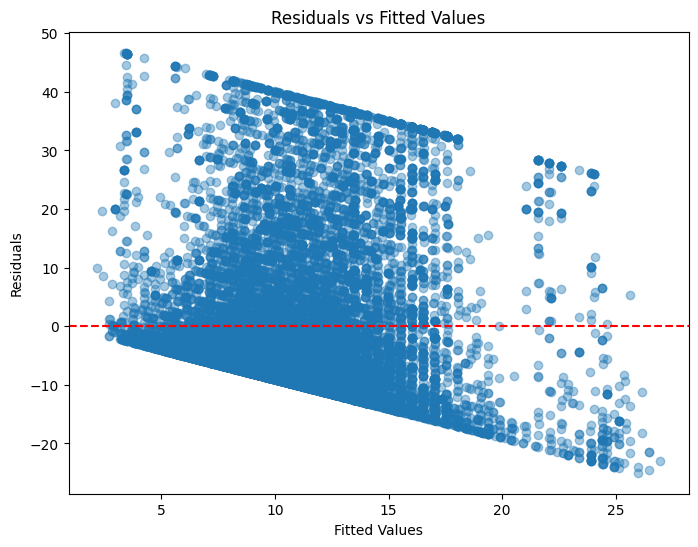

Final Model Metrics:
R-squared: 0.0675
Adjusted R-squared: 0.0673
Mean Squared Error: 169.3082


In [66]:
# linear regression with independent variables: 'Year', 'Month', 'Lat', 'Lon', 'GRAVID'
ind_vars = ['Year', 'Month', 'Lat', 'Lon', 'GRAVID']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

We get very similar metric values when we switch out week for month and all coefficients remain statistically significant. There is some risk that treating months and weeks as numerical variables is creating issues in our model. To try addressing this, we encode the Month variable using its sine and cosine transformations to represent it as a point on the unit circle. This approach addresses the issue that raw month numbers (e.g., 5 for May, 10 for October) could falsely imply a linear relationship, even though months are inherently cyclical. Using sine and cosine values is a common technique to preserve the periodic nature of variables like month or time of year, allowing the model to better capture seasonal patterns.

In [67]:
#encode the month variable using its sine and cosine transformations
num_mosquito_df['Month_sin'] = np.sin(2 * np.pi * num_mosquito_df['Month'] / 12)
num_mosquito_df['Month_cos'] = np.cos(2 * np.pi * num_mosquito_df['Month'] / 12)

In [68]:
#check a heatmap to ensure there is no new colinearity between independent variables after this change
gen_corr_heatmap(num_mosquito_df)

We observe from the above heatmap that encoding the month variable did not generate any new correlation, except between the month_sin and month_cos columns themselves, which is to be expected and necessary for this approach. We proceed by running a linear regression again while replacing month with the encoded variables.

Here is a summary of our OLS results using independent variables ['Year', 'Month_sin', 'Month_cos', 'Lat', 'Lon', 'GRAVID'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.076
Model:                            OLS   Adj. R-squared:                  0.076
Method:                 Least Squares   F-statistic:                     255.0
Date:                Sun, 04 May 2025   Prob (F-statistic):          1.46e-314
Time:                        20:32:04   Log-Likelihood:                -73610.
No. Observations:               18495   AIC:                         1.472e+05
Df Residuals:                   18488   BIC:                         1.473e+05
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-----

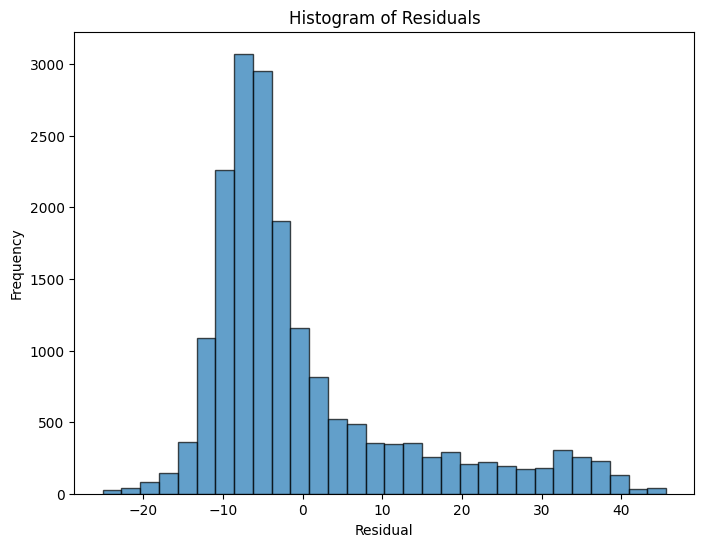




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Year', 'Month_sin', 'Month_cos', 'Lat', 'Lon', 'GRAVID'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


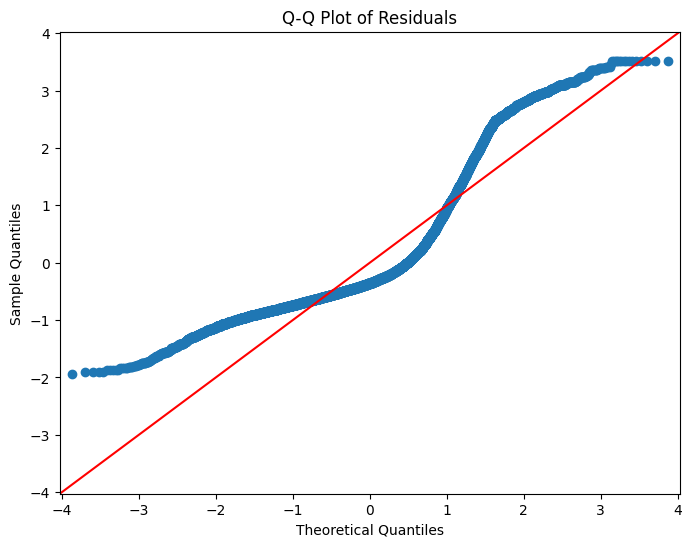




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Year', 'Month_sin', 'Month_cos', 'Lat', 'Lon', 'GRAVID'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



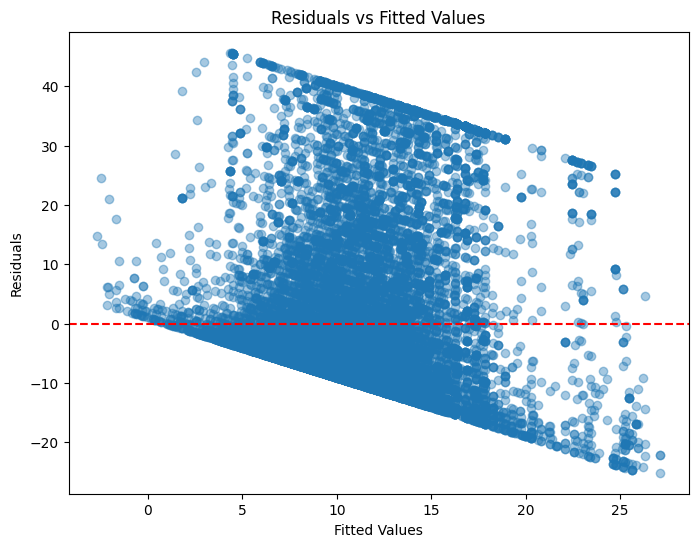

Final Model Metrics:
R-squared: 0.0764
Adjusted R-squared: 0.0761
Mean Squared Error: 167.6888


In [69]:
# linear regression with independent variables: 'Year', 'Month_sin', 'Month_cos','Lat', 'Lon', 'GRAVID'
ind_vars = ['Year', 'Month_sin','Month_cos', 'Lat', 'Lon', 'GRAVID']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

After making these changes, we see all of our model metrics improve, achieving new values of R-squared: 0.0764, Adjusted R-squared: 0.0761,
and Mean Squared Error: 167.6888. Our new model coefficients are also statistically significant in terms of p-value. However, our visualizations still indicate Assumptions 3 and 4 may be violated. We proceed by checking if latitude and longitude are causing these issues, since we did observe some potentially problematic correlation between those variables.

Here is a summary of our OLS results using independent variables ['Year', 'Month_sin', 'Month_cos', 'GRAVID'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.053
Model:                            OLS   Adj. R-squared:                  0.053
Method:                 Least Squares   F-statistic:                     260.8
Date:                Sun, 04 May 2025   Prob (F-statistic):          1.94e-218
Time:                        20:32:04   Log-Likelihood:                -73838.
No. Observations:               18495   AIC:                         1.477e+05
Df Residuals:                   18490   BIC:                         1.477e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-------------------

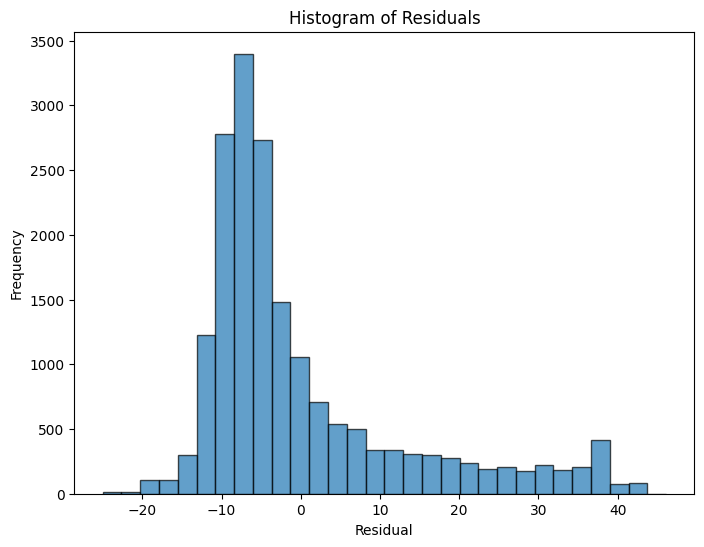




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Year', 'Month_sin', 'Month_cos', 'GRAVID'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


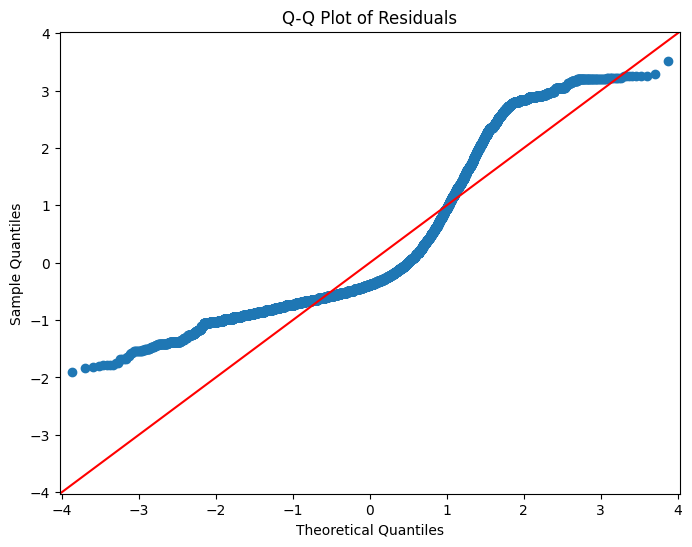




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Year', 'Month_sin', 'Month_cos', 'GRAVID'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



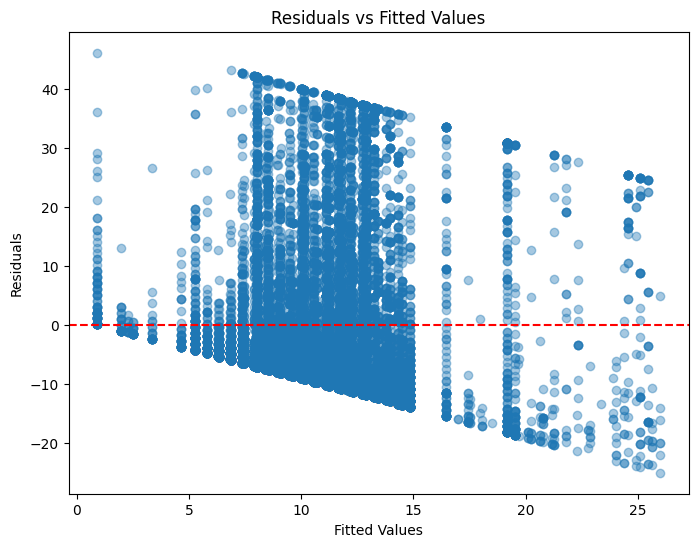

Final Model Metrics:
R-squared: 0.0534
Adjusted R-squared: 0.0532
Mean Squared Error: 171.8690


In [70]:
# linear regression with independent variables: 'Year', 'Month_sin', 'Month_cos', 'GRAVID'
ind_vars = ['Year', 'Month_sin','Month_cos', 'GRAVID']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

Dropping latitude and longitude deprecates our model metrics without improving our visualizations of Assumptions 3 and 4 so we add these columns back and check to see if Year might be the variable creating problems.

Here is a summary of our OLS results using independent variables ['Month_sin', 'Month_cos', 'GRAVID', 'Lat', 'Lon'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.058
Model:                            OLS   Adj. R-squared:                  0.058
Method:                 Least Squares   F-statistic:                     229.2
Date:                Sun, 04 May 2025   Prob (F-statistic):          3.56e-238
Time:                        20:32:05   Log-Likelihood:                -73789.
No. Observations:               18495   AIC:                         1.476e+05
Df Residuals:                   18489   BIC:                         1.476e+05
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-------------

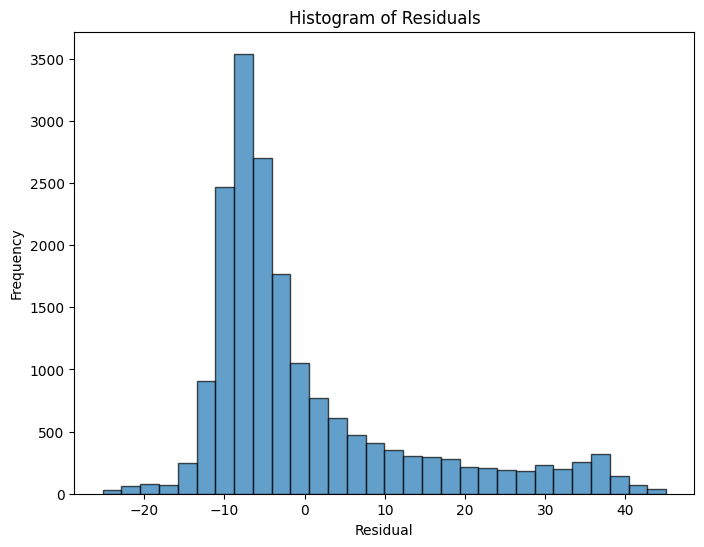




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Month_sin', 'Month_cos', 'GRAVID', 'Lat', 'Lon'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


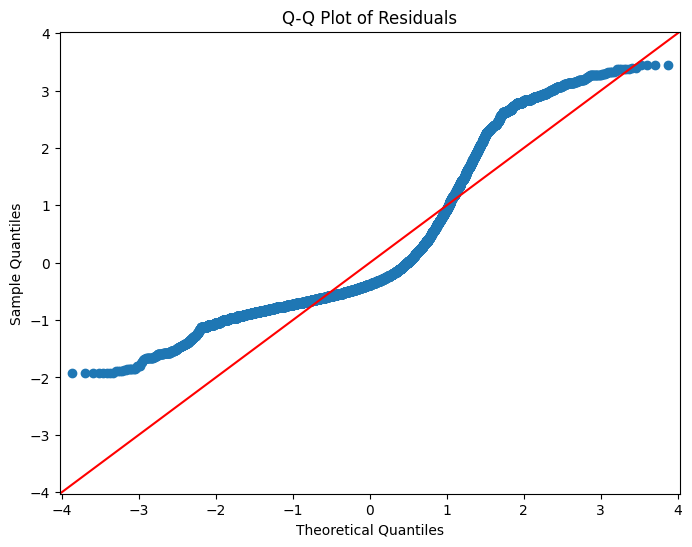




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Month_sin', 'Month_cos', 'GRAVID', 'Lat', 'Lon'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



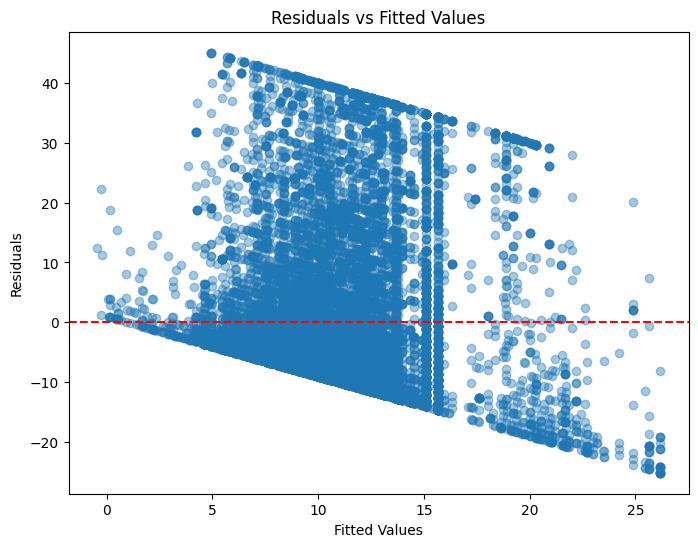

Final Model Metrics:
R-squared: 0.0584
Adjusted R-squared: 0.0581
Mean Squared Error: 170.9712


In [71]:
# linear regression with independent variables: 'Month_sin','Month_cos', 'GRAVID','Lat','Lon'
ind_vars = ['Month_sin','Month_cos', 'GRAVID','Lat','Lon']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

Dropping Year again deprecates our model metrics without improving our visualizations of Assumptions 3 and 4 so we add this column back and check to see if the GRAVID test type might be the variable creating problems.

Here is a summary of our OLS results using independent variables ['Month_sin', 'Month_cos', 'Year', 'Lat', 'Lon'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.047
Model:                            OLS   Adj. R-squared:                  0.047
Method:                 Least Squares   F-statistic:                     183.0
Date:                Sun, 04 May 2025   Prob (F-statistic):          7.82e-191
Time:                        20:32:05   Log-Likelihood:                -73899.
No. Observations:               18495   AIC:                         1.478e+05
Df Residuals:                   18489   BIC:                         1.479e+05
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

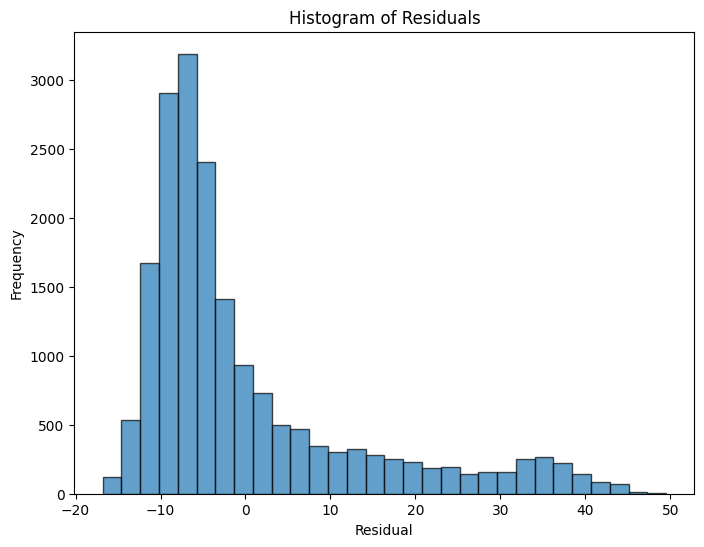




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Month_sin', 'Month_cos', 'Year', 'Lat', 'Lon'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


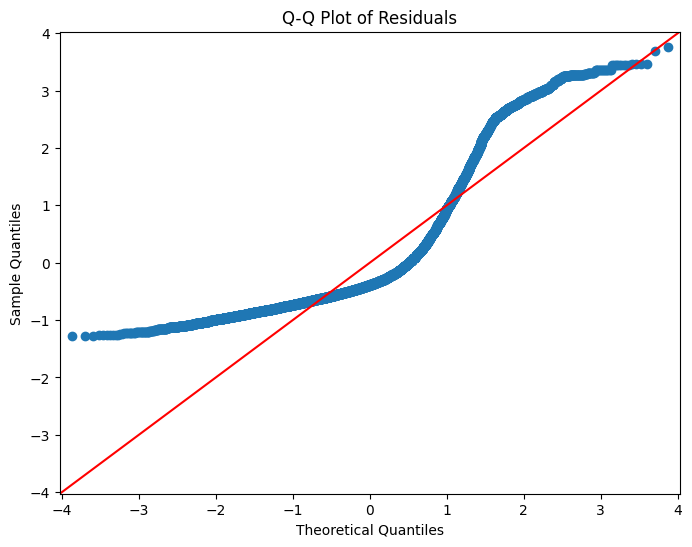




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Month_sin', 'Month_cos', 'Year', 'Lat', 'Lon'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



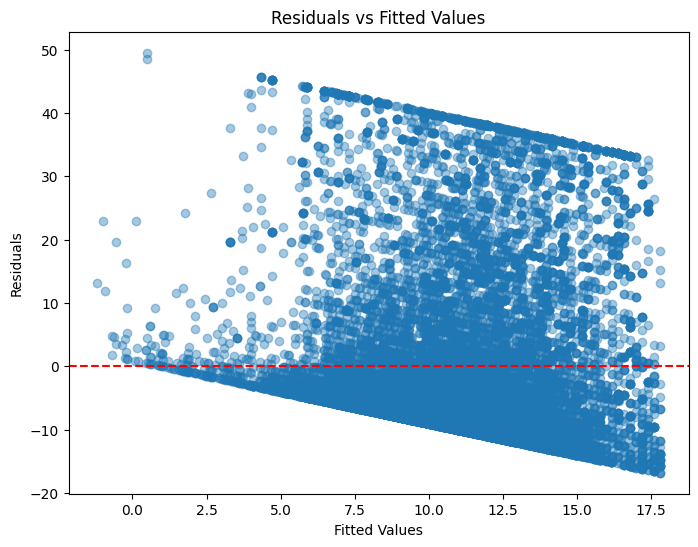

Final Model Metrics:
R-squared: 0.0472
Adjusted R-squared: 0.0469
Mean Squared Error: 173.0051


In [72]:
# linear regression with independent variables: 'Year', 'Month_sin', 'Month_cos', 'Lat','Lon'
ind_vars = ['Month_sin','Month_cos', 'Year','Lat','Lon']
target = 'Mosquito number'
lin_reg_model(num_mosquito_df,target,ind_vars)

Again, this only weakens our model without addressing Assumptions 3 or 4. As a final theory for what may be reducing our models' efficacy and/or violating Assumptions 3 and 4, we recall the fact that our Mosquito number variable is capped artificially at 50. This upper bound on our data is potentially misleading and could lead to issues in our data as some of the Mosquito counts do not accurately reflect how many mosquitos were in the trap at the time of the given test. To try addressing this, we remove those maximum mosquito counts from our data set.

In [73]:
#remove rows where mosquito count is 50
df_uncapped = num_mosquito_df[num_mosquito_df['Mosquito number'] < 50].copy()

Here is a summary of our OLS results using independent variables ['Year', 'Month_sin', 'Month_cos', 'GRAVID', 'Lat', 'Lon'].

                            OLS Regression Results                            
Dep. Variable:        Mosquito number   R-squared:                       0.060
Model:                            OLS   Adj. R-squared:                  0.059
Method:                 Least Squares   F-statistic:                     188.1
Date:                Sun, 04 May 2025   Prob (F-statistic):          2.92e-233
Time:                        20:32:05   Log-Likelihood:                -68261.
No. Observations:               17848   AIC:                         1.365e+05
Df Residuals:                   17841   BIC:                         1.366e+05
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
-----

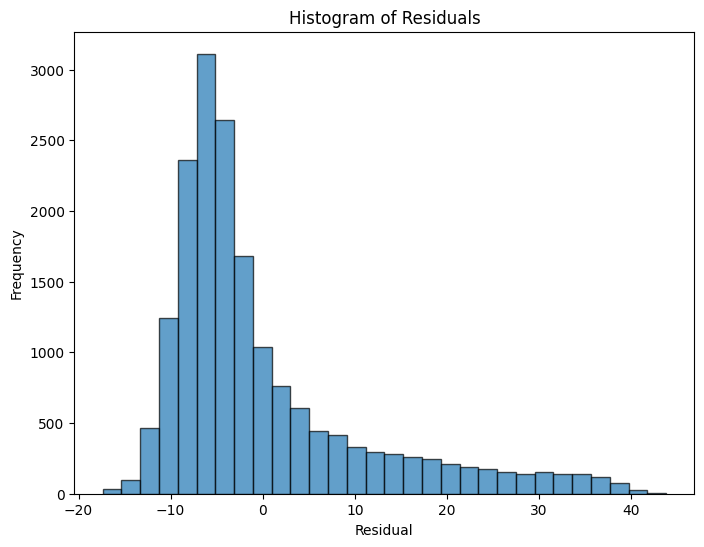




Here is a Normal Q-Q Plot of our residuals using dependent variable Mosquito number independent variables ['Year', 'Month_sin', 'Month_cos', 'GRAVID', 'Lat', 'Lon'].
    If our residuals are normally distributed, the points below should approximately fall on the red line.


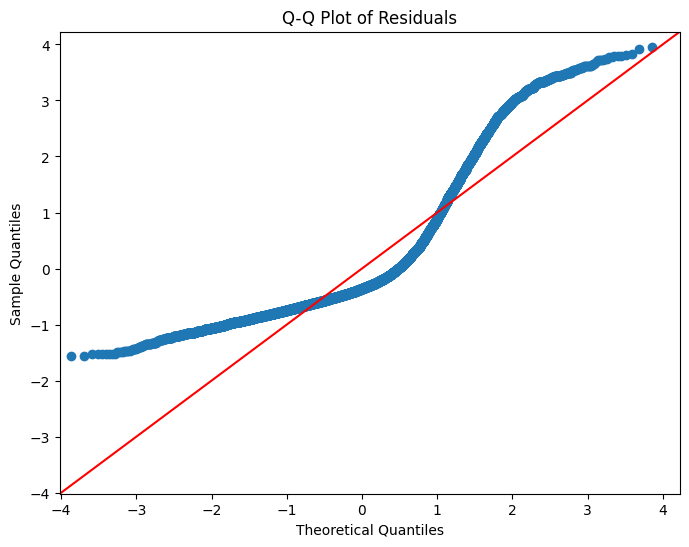




Here is a scatter plot of our residuals against fitted values using dependent variable Mosquito number and independent variables ['Year', 'Month_sin', 'Month_cos', 'GRAVID', 'Lat', 'Lon'].
    If our model satisfies homoscedasticity, there should be no clear trend in this plot.



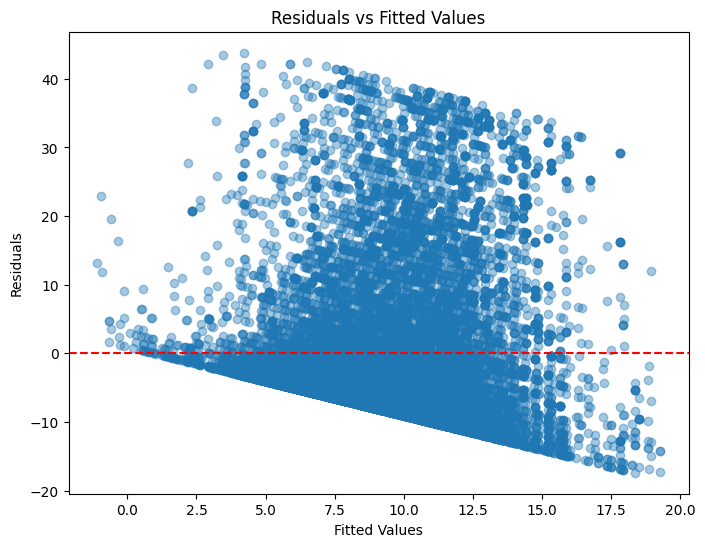

Final Model Metrics:
R-squared: 0.0595
Adjusted R-squared: 0.0592
Mean Squared Error: 122.8859


In [74]:
# linear regression uncapped data and with independent variables: 'Year', 'Month_sin', 'Month_cos', 'GRAVID', 'Lat','Lon'
ind_vars = ['Year', 'Month_sin', 'Month_cos', 'GRAVID', 'Lat','Lon']
target = 'Mosquito number'
lin_reg_model(df_uncapped,target,ind_vars)

After removing all rows with mosquito counts equal to 50 (the artificial upper cap imposed during data collection), we obtain updated model metrics: R-squared: 0.0595, Adjusted R-squared: 0.0592, and Mean Squared Error (MSE): 122.8859. While the R-squared values have slightly decreased compared to earlier iterations, which hovered around 0.07, the substantial drop in MSE from approximately 169 to 123 suggests a notable improvement in the model’s predictive accuracy. Given that MSE is often a more informative metric for assessing model performance in the presence of outliers or large datasets, we consider this change an overall improvement. For this reason, we will retain this choice of independent variables with the uncapped version of the dataset as the final and best iteration of our linear regression model.

It is important to acknowledge that visual diagnostics of the residuals suggest that some model assumptions may not hold. The histogram of residuals appears skewed, and the Q-Q plot deviates from the expected linear pattern, indicating that residuals may not be normally distributed. Additionally, the residuals vs. fitted values scatter plot shows possible clustering behavior, suggesting potential issues with homoscedasticity—though further investigation would be needed to confirm this. In any case, because assumptions 3 (normality of residuals) and 4 (homoscedasticity) could not be clearly verified at any stage of the modeling process, we acknowledge they may not be fully satisfied and accept that this model represents the best available version given the data and constraints.

## 3.2 Logistic Regression

### Run a logistic regression to determine how the independent variables affect West Nile Virus presence. Explain your model construction process. Analyze the model and the results and discuss the model’s limitations. This may end up being an iterative process. Note: Mosquito number should be one of your independent variables.

#### 3.2.1 Preparing the Data for Logistic Regression

In [75]:
#check ratio of positive WNV tests
print(mosquito_df['WNV Present Binary'].mean())

0.21595025682616922


In this case, we avoid relying exclusively on classification accuracy because the WNV Present variable is highly imbalanced—only about 21.6% of the tests come back positive. A model that always predicts "no virus" could still achieve over 78% accuracy while failing to identify any true positives. To address this imbalance and better evaluate model performance, we add three additional metrics: precision, recall, and the F1 score. Precision tells us how many of the predicted positives were actually correct, recall measures how many of the actual positives were correctly identified, and the F1 score balances both by calculating their harmonic mean. These metrics provide a more nuanced and reliable assessment of model quality, especially when positive cases are rare but critical to detect.

To start the modeling process, we create a dataframe with some unnecessary or unwieldy columns dropped. Specifically, we will not use Address Block or Trap number as location is precisely covered by latitude and longitude. Moreover, we will use month encoded as sine and cosine as we did in our linear regression (dropping Week and Date) as this yielded the best results previously. Similarly, we keep only GRAVID test type to minimize multicolinearity in our independent variables (we choose the test type that worked best for our linear regression).

In [76]:
#drop columns we will not use and encode month to make a new dataframe and simplify modeling process
mosquito_df['Month_sin'] = np.sin(2 * np.pi * mosquito_df['Month'] / 12) #encode the month variable using its sine and cosine transformations
mosquito_df['Month_cos'] = np.cos(2 * np.pi * mosquito_df['Month'] / 12)
log_df = mosquito_df.drop(columns = ['Address Block','Trap','Trap type','Week','Date', 'CDC','OVI','SENTINEL','Month'])

In [77]:
#create dummies for categorical variable Species
species_dummies = pd.get_dummies(log_df['Species'],dtype=int)
log_df = pd.concat([log_df, species_dummies],axis=1)
log_df.drop(columns = ['Species'],inplace = True) #drop string Species column

In [78]:
#check heatmap for correlation
gen_corr_heatmap(log_df)

Since correlation between independent variables has the potential to negatively impact logistic regression models, we check another heatmap to detect potential collinearity, especially for the variables we just added. We do not observe any correlations we have not already addressed, except for some minor correlation between our mosquito species dummy columns. This is to be expected but we drop the mosquito species with the fewest records to avoid perfect multicollinearity between these columns.

In [79]:
#drop the CULEX SALINARIUS column which has the fewest records
display(mosquito_df['Species'].value_counts())
log_df.drop(columns = ['CULEX SALINARIUS'],inplace = True)

Species
CULEX RESTUANS      11866
CULEX PIPIENS        5486
CULEX TERRITANS       917
CULEX SALINARIUS      226
Name: count, dtype: int64

#### 3.2.2 Constructing our Logistic Regression Model

We can now start the logistic regression process. Given the small number of variables, we proceed with a backward selection approach to choose our independent variables.

To streamline and systematize the logistic regression process, we define a set of reusable functions that help fit the model, evaluate its performance, and analyze how prediction quality changes across different classification thresholds. The **run_logistic_regression** function fits a logistic regression model using the specified independent variables and returns both the fitted model and the predicted probabilities for the target variable. The **evaluate_binary_predictions** function then takes the true labels and predicted probabilities, applies a user-defined threshold (defaulting to 0.5), and prints key classification metrics: accuracy, precision, recall, and F1 score—metrics especially important given the imbalance in our target variable. Finally, **logistic_model_with_threshold_analysis** automates threshold tuning by computing the F1 score across a range of thresholds (from 0.01 to 0.99), plotting the results, and selecting the threshold that maximizes the F1 score. This process ensures that we evaluate the model not just at an arbitrary cutoff but in a way that balances precision and recall, which is critical in imbalanced classification problems like predicting West Nile Virus presence.

In [80]:
#define helpful functions to streamline the logistic regression process and facilitate iteration

#run logistic regression
def run_logistic_regression(df, target, ind_vars):
    X = df[ind_vars]
    y = df[target]
    X = sm.add_constant(X) #add constant for intercept
    
    model = sm.Logit(y, X) #instantiate model
    model_results = model.fit(disp=False) #fit model
    display(model_results.summary()) #display model summary
    
    y_prob = model_results.predict(X) #predict probabilities of y = 1 on independent variable values X
    return model_results, y_prob


#evaluate models' predictions using a given probability threshold
def evaluate_binary_predictions(y_true, y_prob, threshold=0.5,print_output = False):
    y_pred = (y_prob >= threshold).astype(int) #predict binary outcomes based on threshold
    acc = accuracy_score(y_true, y_pred) #compute accuracy score
    prec = precision_score(y_true, y_pred) #compute precision score
    rec = recall_score(y_true, y_pred) #compute recall score
    f1 = f1_score(y_true, y_pred) #compute F1 score
    if print_output:
        print(f'''Final model metrics:
        The classification accuracy for threshold {threshold} is {acc:.4f}.
        The precision score for threshold {threshold} is {prec:.4f}.
        The recall score for threshold {threshold} is {rec:.4f}.
        The F1 score for threshold {threshold} is {f1:.4f}.
        ''')


def logistic_model_with_threshold_analysis(df, target_col, feature_cols):
    model, y_prob = run_logistic_regression(df, target_col, feature_cols) #run logistic regression

    y_true = df[target_col].values #store true y values
    thresholds = np.arange(0.01, 1.0, 0.01) #create range of thresholds
    f1_scores = []

    for thresh in thresholds: 
        y_pred = (y_prob >= thresh).astype(int)
        f1 = f1_score(y_true, y_pred) #compute F1 score at each threshold
        f1_scores.append(f1)

    plt.figure(figsize=(8, 5))
    plt.plot(thresholds, f1_scores, marker='o', linestyle='-') #plot F1 Score vs threshold
    plt.xlabel("Threshold")
    plt.ylabel("F1 Score")
    plt.title("Model Performance by F1 Score Over Varying Thresholds")
    plt.grid(True)
    plt.show()

    best_idx = np.argmax(f1_scores)     #identify optimal threshold according to F1 score
    best_thresh = thresholds[best_idx]
    best_f1 = f1_scores[best_idx]

    print(f"\n Optimal threshold: {best_thresh:.2f}\n")
    evaluate_binary_predictions(y_true, y_prob, best_thresh, print_output = True) #evaluate binary predictions with given threshold

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:     WNV Present Binary   No. Observations:                18495
Model:                          Logit   Df Residuals:                    18484
Method:                           MLE   Df Model:                           10
Date:                Sun, 04 May 2025   Pseudo R-squ.:                  0.2900
Time:                        20:32:06   Log-Likelihood:                -6851.0
converged:                       True   LL-Null:                       -9649.5
Covariance Type:            nonrobust   LLR p-value:                     0.000
===================================================================================
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            -571.1563     26.131    -21.858      0.000    -622.371    -519.941
Year                0.1216      0.007     17.963      0.000       0.108       0.135
Mosquito number     0.0680      0.002     43.032      0.000       0.065       0.071
Lat                -0.7961      0.296     -2.690      0.007      -1.376      -0.216
Lon                -3.9803      0.349    -11.421      0.000      -4.663      -3.297
GRAVID              0.3684      0.110      3.344      0.001       0.152       0.584
Month_sin          -7.0512      0.219    -32.264      0.000      -7.480      -6.623
Month_cos          -3.3899      0.149    -22.699      0.000      -3.683      -3.097
CULEX PIPIENS       1.0437      0.328      3.184      0.001       0.401       1.686
CULEX RESTUANS      0.8888      0.327      2.716      0.007       0.247       1.530
CULEX TERRITANS    -1.3375      0.424     -3.152      0.002      -2.169      -0.506
===================================================================================
"""

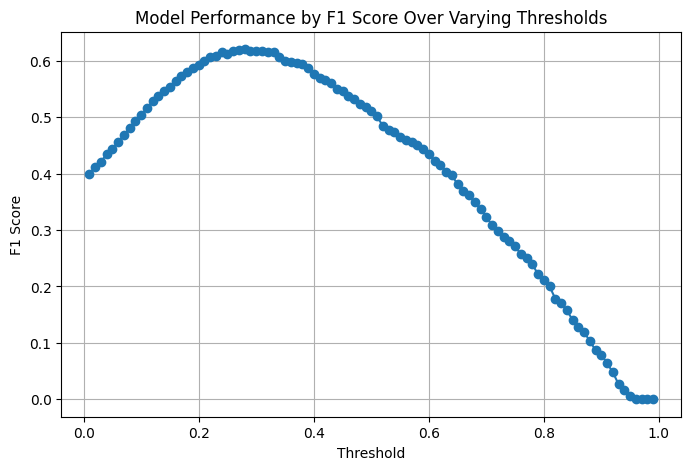


 Optimal threshold: 0.28

Final model metrics:
        The classification accuracy for threshold 0.28 is 0.8116.
        The precision score for threshold 0.28 is 0.5490.
        The recall score for threshold 0.28 is 0.7141.
        The F1 score for threshold 0.28 is 0.6207.
        


In [81]:
#run logistic regression with independent variables: 'Year', 'Mosquito number', 'Lat', 'Lon', 'GRAVID',
#       'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX RESTUANS', 'CULEX TERRITANS'
independent_variables = ['Year', 'Mosquito number', 'Lat', 'Lon', 'GRAVID',
                         'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX RESTUANS', 'CULEX TERRITANS']
target = 'WNV Present Binary'
logistic_model_with_threshold_analysis(log_df,target,independent_variables)

We find the model has an optimal threshold of .28 which achieves model metrics: classification accuracy = 0.8116, precision score = 0.5490, recall score = 0.7141, F1 score = 0.6207. All the coefficients appear statistically significant with p-values below 0.05. However, it is not intuitive that trap type would affect the probability of a positive WNV test. We run the model again dropping the GRAVID variable.

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:     WNV Present Binary   No. Observations:                18495
Model:                          Logit   Df Residuals:                    18485
Method:                           MLE   Df Model:                            9
Date:                Sun, 04 May 2025   Pseudo R-squ.:                  0.2894
Time:                        20:32:06   Log-Likelihood:                -6856.8
converged:                       True   LL-Null:                       -9649.5
Covariance Type:            nonrobust   LLR p-value:                     0.000
===================================================================================
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            -585.5289     25.792    -22.702      0.000    -636.081    -534.977
Year                0.1245      0.007     18.545      0.000       0.111       0.138
Mosquito number     0.0668      0.002     43.600      0.000       0.064       0.070
Lat                -0.7746      0.296     -2.619      0.009      -1.354      -0.195
Lon                -4.0714      0.347    -11.726      0.000      -4.752      -3.391
Month_sin          -7.0212      0.218    -32.194      0.000      -7.449      -6.594
Month_cos          -3.3919      0.149    -22.720      0.000      -3.685      -3.099
CULEX PIPIENS       1.0686      0.329      3.250      0.001       0.424       1.713
CULEX RESTUANS      0.9173      0.328      2.794      0.005       0.274       1.561
CULEX TERRITANS    -1.3073      0.425     -3.075      0.002      -2.141      -0.474
===================================================================================
"""

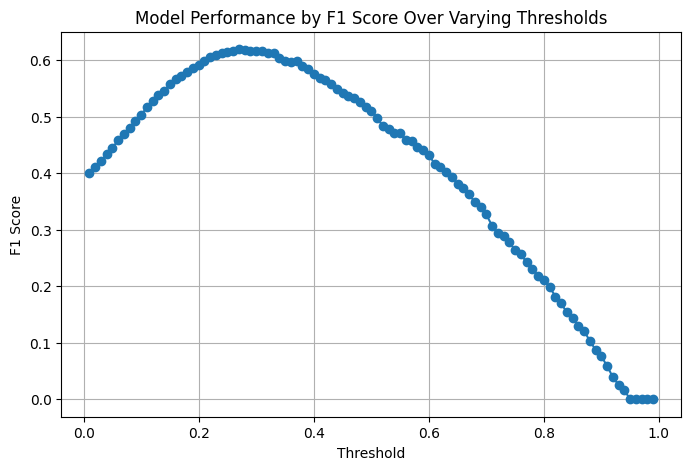


 Optimal threshold: 0.27

Final model metrics:
        The classification accuracy for threshold 0.27 is 0.8069.
        The precision score for threshold 0.27 is 0.5391.
        The recall score for threshold 0.27 is 0.7278.
        The F1 score for threshold 0.27 is 0.6194.
        


In [82]:
#run logistic regression with independent variables: 'Year', 'Mosquito number', 'Lat', 'Lon', 
#       'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX RESTUANS', 'CULEX TERRITANS'
independent_variables = ['Year', 'Mosquito number', 'Lat', 'Lon', 'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX RESTUANS', 'CULEX TERRITANS']
target = 'WNV Present Binary'
logistic_model_with_threshold_analysis(log_df,target,independent_variables)

We find the model has an optimal threshold of .27 which achieves model metrics: classification accuracy = 0.8069, precision score = 0.5391, recall score = 0.7278, F1 score = 0.6194. Compared to our model which included the GRAVID trap type, our classification accuracy and F1 Score went down slightly but our precision score and recall score increased. In this case, recall is especially important, since failing to detect positive WNV cases could have public health consequences. We proceed without the GRAVID variable. In order to investigate whether our mosquito species dummy variables are truly improving the model, we test to see what happens if we drop the CULEX RESTUANS column, which has the highest p-value at 0.005 (although it is still very small).

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:     WNV Present Binary   No. Observations:                18495
Model:                          Logit   Df Residuals:                    18486
Method:                           MLE   Df Model:                            8
Date:                Sun, 04 May 2025   Pseudo R-squ.:                  0.2889
Time:                        20:32:07   Log-Likelihood:                -6861.7
converged:                       True   LL-Null:                       -9649.5
Covariance Type:            nonrobust   LLR p-value:                     0.000
===================================================================================
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            -586.1197     25.775    -22.740      0.000    -636.637    -535.603
Year                0.1262      0.007     18.846      0.000       0.113       0.139
Mosquito number     0.0671      0.002     43.861      0.000       0.064       0.070
Lat                -0.7626      0.296     -2.578      0.010      -1.342      -0.183
Lon                -4.0450      0.347    -11.657      0.000      -4.725      -3.365
Month_sin          -7.0121      0.218    -32.174      0.000      -7.439      -6.585
Month_cos          -3.3881      0.149    -22.695      0.000      -3.681      -3.095
CULEX PIPIENS       0.1659      0.052      3.192      0.001       0.064       0.268
CULEX TERRITANS    -2.2115      0.274     -8.070      0.000      -2.749      -1.674
===================================================================================
"""

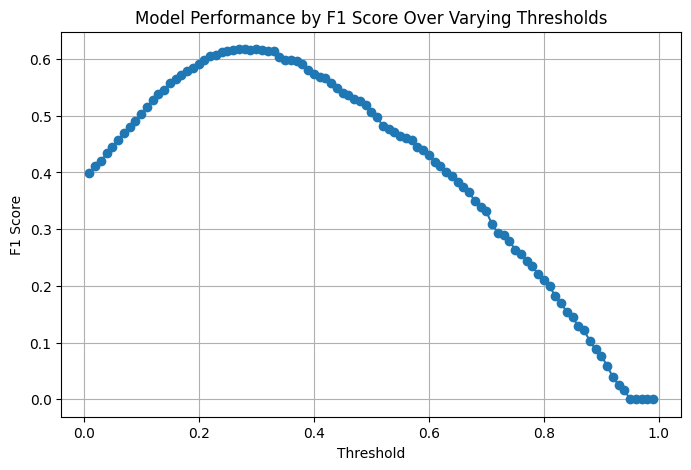


 Optimal threshold: 0.27

Final model metrics:
        The classification accuracy for threshold 0.27 is 0.8063.
        The precision score for threshold 0.27 is 0.5382.
        The recall score for threshold 0.27 is 0.7241.
        The F1 score for threshold 0.27 is 0.6175.
        


In [83]:
#run logistic regression with independent variables: 'Year', 'Mosquito number', 'Lat', 'Lon', 
#       'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX TERRITANS'
independent_variables = ['Year', 'Mosquito number', 'Lat', 'Lon', 'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX TERRITANS']
target = 'WNV Present Binary'
logistic_model_with_threshold_analysis(log_df,target,independent_variables)

We find that removing the CULEX  RESTUANS column deprecates all of our model's evaluation metrics. While the difference is minor, we still conclude incorporating mosquito species is valuable for our model, especially since we already verified there is statistically significant disparity in WNV prevalence across different species in Section 2.1. We next check to see if our encoded month columns are benefiting the model by observing what happens when we remove them.

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:     WNV Present Binary   No. Observations:                18495
Model:                          Logit   Df Residuals:                    18487
Method:                           MLE   Df Model:                            7
Date:                Sun, 04 May 2025   Pseudo R-squ.:                  0.1839
Time:                        20:32:07   Log-Likelihood:                -7875.0
converged:                       True   LL-Null:                       -9649.5
Covariance Type:            nonrobust   LLR p-value:                     0.000
===================================================================================
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            -524.3423     24.053    -21.800      0.000    -571.485    -477.200
Year                0.1251      0.006     19.745      0.000       0.113       0.137
Mosquito number     0.0586      0.001     43.696      0.000       0.056       0.061
Lat                -0.4919      0.277     -1.778      0.075      -1.034       0.050
Lon                -3.3084      0.323    -10.229      0.000      -3.942      -2.675
CULEX RESTUANS      0.6531      0.318      2.054      0.040       0.030       1.276
CULEX PIPIENS       1.3910      0.318      4.372      0.000       0.767       2.015
CULEX TERRITANS    -1.3474      0.416     -3.238      0.001      -2.163      -0.532
===================================================================================
"""

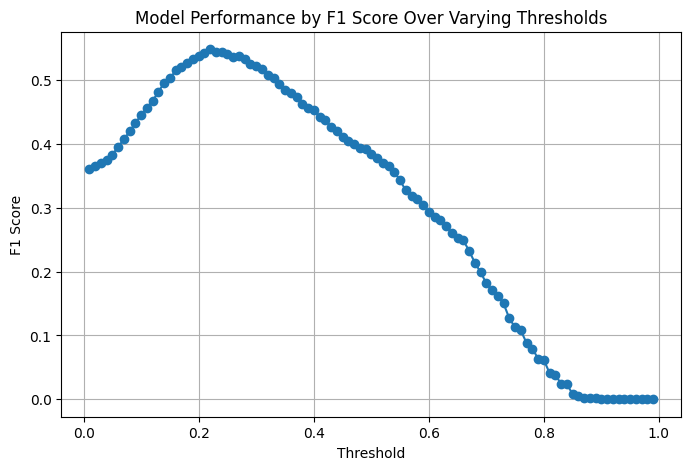


 Optimal threshold: 0.22

Final model metrics:
        The classification accuracy for threshold 0.22 is 0.7541.
        The precision score for threshold 0.22 is 0.4544.
        The recall score for threshold 0.22 is 0.6918.
        The F1 score for threshold 0.22 is 0.5485.
        


In [84]:
#run logistic regression with independent variables: 'Year', 'Mosquito number', 'Lat', 'Lon',
#       'CULEX RESTUANS', 'CULEX PIPIENS', 'CULEX TERRITANS'
independent_variables = ['Year', 'Mosquito number', 'Lat', 'Lon', 'CULEX RESTUANS', 'CULEX PIPIENS', 'CULEX TERRITANS']
target = 'WNV Present Binary'
logistic_model_with_threshold_analysis(log_df,target,independent_variables)

We find that removing our encoded month variables deprecates our model's evaluation metrics very substantially. We conclude these variables are quite important to our models' efficacy. The remaining variables we have not tried removing are all essential to our analysis as we operate with the assumption that year, location, and mosquito number all impact the likelihood of a positive WNV test. With our linear regression, we found removing the artificial capped values (where mosquito number equals 50) improved our model's performance. We now check to see if the same logic applies to logistic regression.

In [85]:
#remove rows where mosquito count is 50
log_df_uncapped = log_df[log_df['Mosquito number'] < 50].copy()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:     WNV Present Binary   No. Observations:                17848
Model:                          Logit   Df Residuals:                    17838
Method:                           MLE   Df Model:                            9
Date:                Sun, 04 May 2025   Pseudo R-squ.:                  0.2835
Time:                        20:32:07   Log-Likelihood:                -6450.0
converged:                       True   LL-Null:                       -9002.0
Covariance Type:            nonrobust   LLR p-value:                     0.000
===================================================================================
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            -583.1869     26.802    -21.759      0.000    -635.719    -530.655
Year                0.1201      0.007     17.388      0.000       0.107       0.134
Mosquito number     0.0743      0.002     40.376      0.000       0.071       0.078
Lat                -0.7660      0.305     -2.511      0.012      -1.364      -0.168
Lon                -4.1399      0.358    -11.562      0.000      -4.842      -3.438
Month_sin          -7.2311      0.235    -30.737      0.000      -7.692      -6.770
Month_cos          -3.5150      0.157    -22.338      0.000      -3.823      -3.207
CULEX RESTUANS      0.9038      0.330      2.737      0.006       0.257       1.551
CULEX PIPIENS       1.0116      0.331      3.058      0.002       0.363       1.660
CULEX TERRITANS    -1.2949      0.427     -3.034      0.002      -2.131      -0.458
===================================================================================
"""

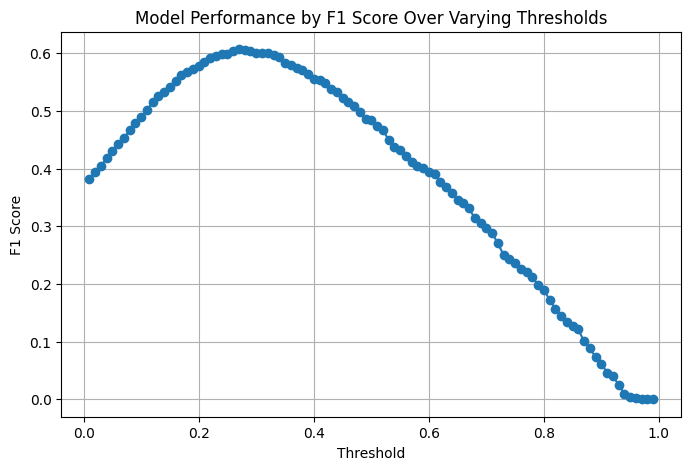


 Optimal threshold: 0.27

Final model metrics:
        The classification accuracy for threshold 0.27 is 0.8138.
        The precision score for threshold 0.27 is 0.5307.
        The recall score for threshold 0.27 is 0.7092.
        The F1 score for threshold 0.27 is 0.6071.
        


In [86]:
#run logistic regression with uncapped data and independent variables: 'Year', 'Mosquito number', 'Lat', 'Lon', 
#     'Month_sin', 'Month_cos', 'CULEX RESTUANS', 'CULEX PIPIENS', 'CULEX TERRITANS'
independent_variables = ['Year', 'Mosquito number', 'Lat', 'Lon', 'Month_sin', 'Month_cos','CULEX RESTUANS', 'CULEX PIPIENS', 'CULEX TERRITANS']
target = 'WNV Present Binary'
logistic_model_with_threshold_analysis(log_df_uncapped,target,independent_variables)

We find that changing to the uncapped data set weakens our model in terms of recall and F1 score. This may imply the data points with mosquito count equal to 50 are quite important to making predictions; if researchers count a very large number of mosquitos (50 or over), there may be a high chance West Nile Virus is present. Accordingly, we stick with the original dataset. We conclude the best iteration of our model is the following version which includes independent variables: Year, Mosquito number, Latitude, Longitude, Month sine, Month cosine, and the dummy columns CULEX PIPIENS, CULEX RESTUANS, CULEX TERRITANS.  

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:     WNV Present Binary   No. Observations:                18495
Model:                          Logit   Df Residuals:                    18485
Method:                           MLE   Df Model:                            9
Date:                Sun, 04 May 2025   Pseudo R-squ.:                  0.2894
Time:                        20:32:08   Log-Likelihood:                -6856.8
converged:                       True   LL-Null:                       -9649.5
Covariance Type:            nonrobust   LLR p-value:                     0.000
===================================================================================
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            -585.5289     25.792    -22.702      0.000    -636.081    -534.977
Year                0.1245      0.007     18.545      0.000       0.111       0.138
Mosquito number     0.0668      0.002     43.600      0.000       0.064       0.070
Lat                -0.7746      0.296     -2.619      0.009      -1.354      -0.195
Lon                -4.0714      0.347    -11.726      0.000      -4.752      -3.391
Month_sin          -7.0212      0.218    -32.194      0.000      -7.449      -6.594
Month_cos          -3.3919      0.149    -22.720      0.000      -3.685      -3.099
CULEX PIPIENS       1.0686      0.329      3.250      0.001       0.424       1.713
CULEX RESTUANS      0.9173      0.328      2.794      0.005       0.274       1.561
CULEX TERRITANS    -1.3073      0.425     -3.075      0.002      -2.141      -0.474
===================================================================================
"""

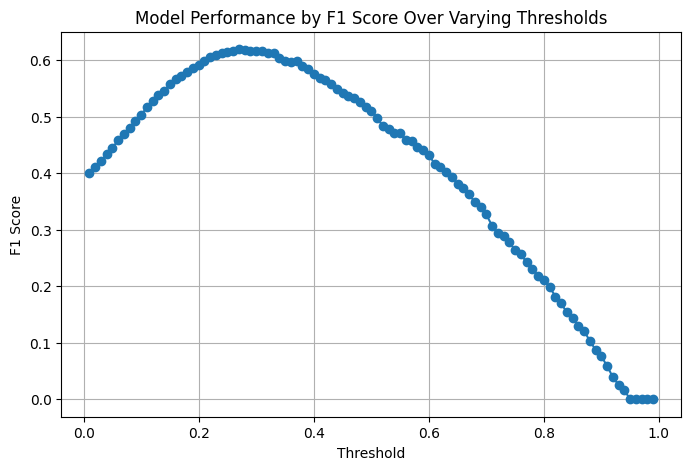


 Optimal threshold: 0.27

Final model metrics:
        The classification accuracy for threshold 0.27 is 0.8069.
        The precision score for threshold 0.27 is 0.5391.
        The recall score for threshold 0.27 is 0.7278.
        The F1 score for threshold 0.27 is 0.6194.
        


In [87]:
#run logistic regression with independent variables: 'Year', 'Mosquito number', 'Lat', 'Lon', 
#       'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX RESTUANS', 'CULEX TERRITANS'
independent_variables = ['Year', 'Mosquito number', 'Lat', 'Lon', 'Month_sin', 'Month_cos', 'CULEX PIPIENS', 'CULEX RESTUANS', 'CULEX TERRITANS']
target = 'WNV Present Binary'
logistic_model_with_threshold_analysis(log_df,target,independent_variables)

To summarize, our logistic regression modeling process involved iteratively testing different combinations of independent variables and classification thresholds to identify the most balanced and effective model for predicting West Nile Virus presence. After evaluating performance using precision, recall, and F1 score, we identified the best-performing model directly above. This model, evaluated at an optimal threshold of 0.27, achieved a classification accuracy of 0.8069, a precision of 0.5391, a recall of 0.7278, and an F1 score of 0.6194, indicating a strong balance between identifying positive cases and minimizing false positives. While the model performs well overall, it still has limitations: the relatively modest precision means that a fair number of false positives occur, and the structure of logistic regression may not fully capture complex nonlinear relationships in the data. Nonetheless, this version represents our most effective and interpretable model given the available data and resources.

# Conclusion

Through a combination of exploratory data analysis, statistical testing, and predictive modeling, this notebook provides insight into the environmental and biological factors influencing mosquito populations and WNV transmission risk. While the linear regression model had limited explanatory power (as reflected by low R² values), it revealed meaningful spatial and temporal patterns in mosquito abundance. The logistic regression model, which incorporated mosquito counts, geographic coordinates, seasonal encoding, and mosquito species, achieved a strong balance of precision and recall, with an optimal F1 score of 0.6194 at a tuned classification threshold. This performance underscores the model’s utility despite the inherent limitations of logistic regression. Overall, this analysis demonstrates the importance of iterative model refinement, threshold tuning, and appropriate metric selection when applying statistical methods to real-world public health data.